In [1]:
import pandas as pd

from sodapy import Socrata


import geopandas as gpd


import contextily as ctx


import esda
from esda.moran import Moran, Moran_Local

import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation

import libpysal as lps


import matplotlib.pyplot as plt
import plotly.express as px

In [2]:
dataset = pd.read_csv("census_tracts_data.csv")
#  census_tracts_data

In [3]:
dataset = dataset.dropna(axis=1,how="all")

In [4]:
# columns_to_keep1
columns_to_keep = ['Geo_FIPS',
                   'SE_A03001_001',
                  'SE_A03001_002',
                  'SE_A03001_003',
                  'SE_A03001_005',
                  'SE_A01001_011',
                  'SE_A01001_012',
                  'SE_A01001_013',
                  'SE_A14001_001',
                  'SE_A14001_002',
                  'SE_A14001_003',
                  'SE_A14001_004',
                  'SE_A14001_005',
                  'SE_A14001_006',
                  'SE_A14001_007',
                  'SE_A14001_008',
                  'SE_A09005_001',
                  'SE_A09005_003']

dataset2 = dataset[columns_to_keep]

In [5]:
dataset2.columns = ['FIPS',
'Total Population','White Alone','Black or African American Alone',
                   'Asian Alone', '65 to 74 years', '75 to 84 years', '85 years and above',
                   'Households','Less than $10,000', '$10,000 to $14,999', '$15,000 to $19,999',
                   '$20,000 to $24,999', '$25,000 to 29,999','$30,000 to $34,999','$35,000 to $39,999',
                   'Workers 16 years and over','Public Transportation (Includes Taxicab)']

In [6]:
geom_data = pd.read_csv('bus_route_tracts.csv')

In [7]:
geom_data = geom_data.rename(columns = {"GEOID":"FIPS"})
geom_data = geom_data[["FIPS", "geometry"]]

In [8]:
joined_data = dataset2.merge(right=geom_data, on="FIPS")
joined_data.head()

,FIPS,Total Population,White Alone,Black or African American Alone,Asian Alone,65 to 74 years,75 to 84 years,85 years and above,Households,"Less than $10,000","$10,000 to $14,999","$15,000 to $19,999","$20,000 to $24,999","$25,000 to 29,999","$30,000 to $34,999","$35,000 to $39,999",Workers 16 years and over,Public Transportation (Includes Taxicab),geometry
0,6001400200,2038,1498,48,197,294,152,28,868,0,19,0,0,0,8,2,1096,318,POLYGON ((-13609668.02650254 4557245.143044413...
1,6001400300,5449,3410,530,640,548,217,208,2548,78,104,47,85,60,46,0,3289,954,POLYGON ((-13610540.43735189 4556544.289386773...
2,6001400400,4384,3061,367,356,346,121,65,1826,32,42,69,25,37,15,10,2584,500,POLYGON ((-13610121.87606651 4557100.091216017...
3,6001401100,5204,2441,933,914,256,43,38,2428,174,11,41,101,47,0,66,3257,1373,POLYGON ((-13610864.48838959 4554707.239539972...
4,6001401200,2800,1796,286,312,138,79,24,1360,26,44,30,10,43,73,21,1872,523,POLYGON ((-13610152.04364851 4554551.794405404...


In [9]:
joined_data['geometry'] = gpd.GeoSeries.from_wkt(joined_data['geometry'])
geo_df = gpd.GeoDataFrame(joined_data, geometry='geometry')

In [10]:
joined_data['Seniors'] = joined_data['65 to 74 years'] + joined_data ['75 to 84 years'] + joined_data['85 years and above']

In [11]:
joined_data['PCT_Seniors'] = joined_data['Seniors']/joined_data['Total Population']*100

In [12]:
from matplotlib.patches import Patch

In [13]:
import matplotlib.patches as mpatches

In [14]:
import contextily as cx

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


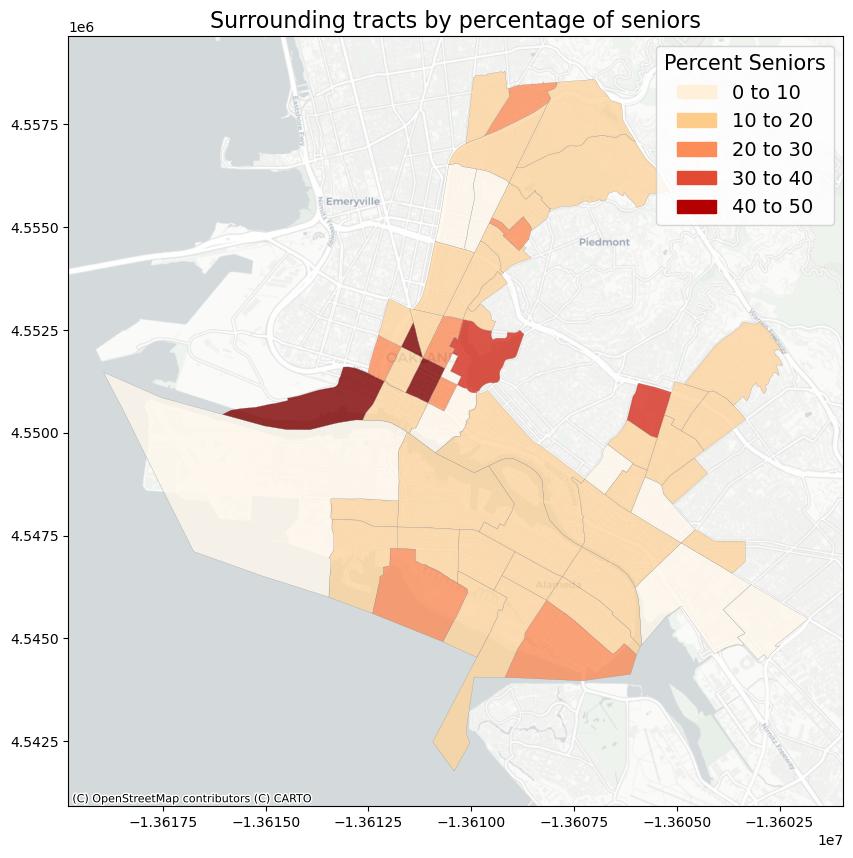

In [15]:
bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#fef0d9', label='0 to 10') 
bl_2 = mpatches.Patch(color='#fdcc8a', label='10 to 20')
bl_3 = mpatches.Patch(color='#fc8d59', label='20 to 30')
bl_4 = mpatches.Patch(color='#e34a33', label='30 to 40')
bl_5 = mpatches.Patch(color='#b30000', label='40 to 50')

ax_bl = geo_df.plot(figsize=(12,10),
                         column='PCT_Seniors',
                         legend=True,
                         cmap='OrRd',
                         scheme='UserDefined',
                         classification_kwds={'bins': bins_bl},
                         linewidth=0.2,
                         edgecolor='grey',
                         alpha=0.8,
                         legend_kwds={
                              'loc': 'upper right',
                              'bbox_to_anchor':(1,1),
                              'title': 'Percent Seniors',
                              'title_fontsize': 15,
                              'fontsize': 14,
                              'handles': [bl_1, bl_2, bl_3, bl_4, bl_5]
                         })
cx.add_basemap(ax_bl, source=cx.providers.CartoDB.Positron)
plt.title(label="Surrounding tracts by percentage of seniors",
          fontsize=16,
          color="black");

In [16]:

wq =  lps.weights.KNN.from_dataframe(geo_df,k=8)


wq.transform = 'r'

In [17]:
geo_df['PCT_Seniors_lag'] = lps.weights.lag_spatial(wq, geo_df['PCT_Seniors'])

In [18]:
geo_df.sample(10)

,FIPS,Total Population,White Alone,Black or African American Alone,Asian Alone,65 to 74 years,75 to 84 years,85 years and above,Households,"Less than $10,000",...,"$20,000 to $24,999","$25,000 to 29,999","$30,000 to $34,999","$35,000 to $39,999",Workers 16 years and over,Public Transportation (Includes Taxicab),geometry,Seniors,PCT_Seniors,PCT_Seniors_lag
53,6001428700,4628,1308,664,1835,277,68,107,1418,138,...,6,53,31,19,1992,200,"POLYGON ((-13618004.966 4551059.049, -13617951...",452,9.766638,19.267722
19,6001403701,3025,1470,633,504,287,102,196,1825,62,...,63,18,17,55,2010,448,"POLYGON ((-13610175.309 4552813.729, -13610170...",585,19.338843,21.079440
28,6001406202,4947,935,638,700,366,131,178,1316,98,...,52,128,12,73,1950,386,"POLYGON ((-13606686.445 4548581.387, -13606671...",675,13.644633,13.761352
9,6001402802,1251,284,583,195,336,124,44,699,176,...,0,0,18,0,419,188,"POLYGON ((-13611662.760 4552162.065, -13611653...",504,40.287770,20.316247
42,6001427300,5036,1914,764,1799,623,239,35,2014,62,...,61,27,42,60,2420,298,"POLYGON ((-13611789.553 4547739.716, -13611786...",897,17.811755,13.423619
8,6001402801,3301,990,1230,582,404,90,40,1786,87,...,42,212,33,80,1828,706,"POLYGON ((-13611476.857 4553015.366, -13611428...",534,16.176916,22.210376
35,6001407101,3813,461,604,1096,363,43,13,1078,157,...,32,139,13,84,1623,207,"POLYGON ((-13605361.409 4548710.404, -13605343...",419,10.988723,12.156949
18,6001403502,2008,1005,451,229,113,119,9,1176,66,...,58,15,63,68,1280,477,"POLYGON ((-13610004.545 4553145.847, -13609996...",241,12.001992,21.484232
31,6001406500,6342,1267,996,1275,734,73,74,1882,162,...,53,42,203,68,2904,494,"POLYGON ((-13605729.098 4549055.631, -13605718...",881,13.891517,13.903617
54,6001982000,48,26,6,14,18,4,0,35,0,...,0,0,0,0,33,23,"POLYGON ((-13615877.094 4550533.012, -13615844...",22,45.833333,20.482406


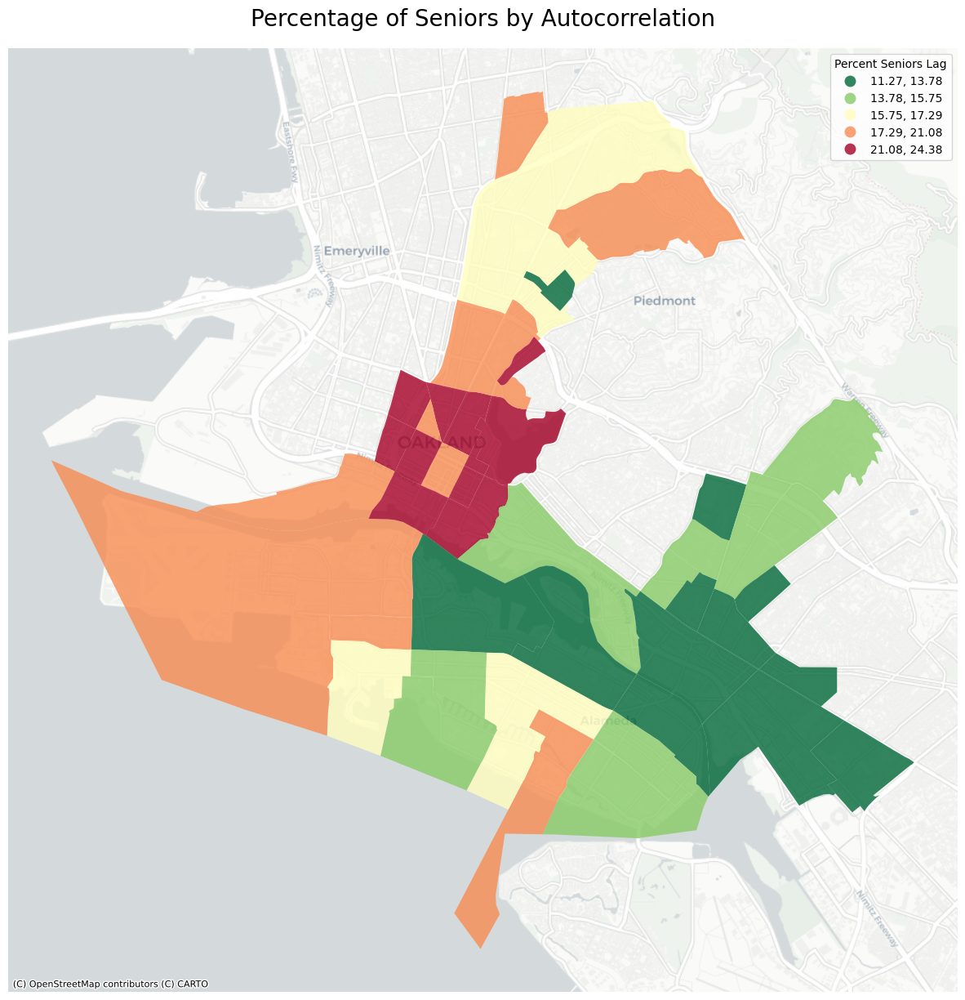

In [19]:
fig, ax = plt.subplots(figsize=(15, 15))


geo_df.plot(ax=ax,
         figsize=(15,15),
         column='PCT_Seniors_lag',
         legend=True,
         alpha=0.8,
         cmap='RdYlGn_r',
         scheme='quantiles',
           legend_kwds={
               'loc': 'upper right',
               'bbox_to_anchor':(1,1),
               'title': 'Percent Seniors Lag'
            })

ax.axis('off')
ax.set_title('Percentage of Seniors by Autocorrelation',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [20]:
geo_df['PCT_Black'] = geo_df['Black or African American Alone']/geo_df['Total Population']*100

In [21]:
geo_df['PCT_Black_lag'] = lps.weights.lag_spatial(wq, geo_df['PCT_Black'])

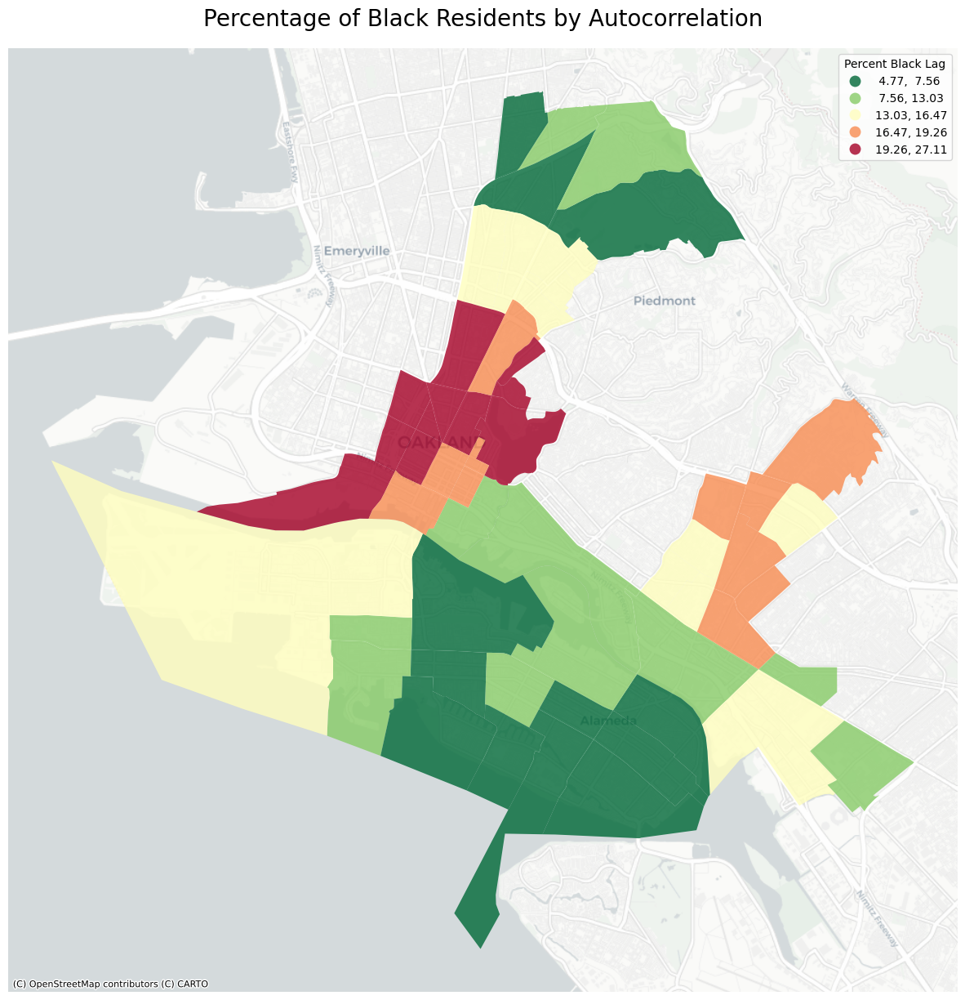

In [22]:
fig, ax = plt.subplots(figsize=(15, 15))


geo_df.plot(ax=ax,
         figsize=(15,15),
         column='PCT_Black_lag',
         legend=True,
         alpha=0.8,
         cmap='RdYlGn_r',
         scheme='quantiles',
           legend_kwds={
               'loc': 'upper right',
               'bbox_to_anchor':(1,1),
               'title': 'Percent Black Lag'
            })

ax.axis('off')
ax.set_title('Percentage of Black Residents by Autocorrelation',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [23]:
geo_df['PCT_Asian'] = geo_df['Asian Alone']/geo_df['Total Population']*100

In [24]:
geo_df['PCT_Asian_lag'] = lps.weights.lag_spatial(wq, geo_df['PCT_Asian'])

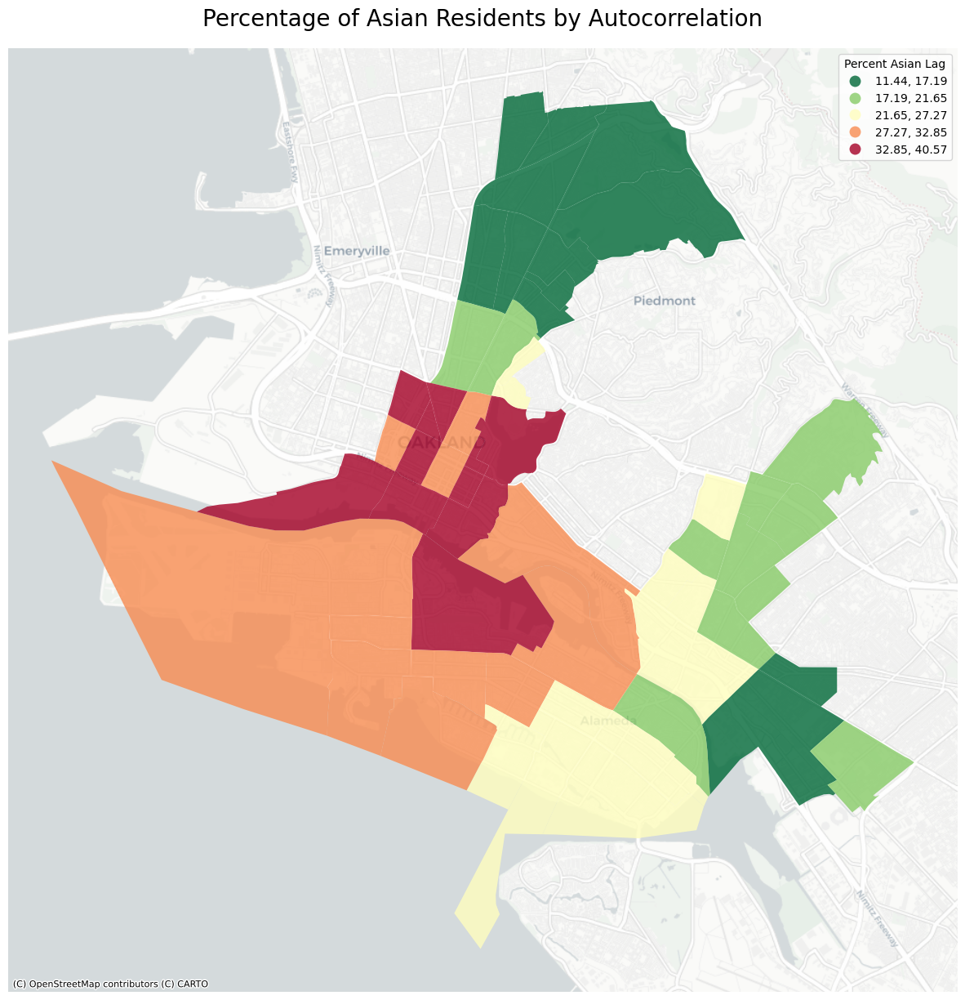

In [25]:
fig, ax = plt.subplots(figsize=(15, 15))


geo_df.plot(ax=ax,
         figsize=(15,15),
         column='PCT_Asian_lag',
         legend=True,
         alpha=0.8,
         cmap='RdYlGn_r',
         scheme='quantiles',
           legend_kwds={
               'loc': 'upper right',
               'bbox_to_anchor':(1,1),
               'title': 'Percent Asian Lag'
            })

ax.axis('off')
ax.set_title('Percentage of Asian Residents by Autocorrelation',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [26]:
geo_df['Low_Income'] = geo_df['Less than $10,000'] + geo_df['$10,000 to $14,999'] + geo_df['$15,000 to $19,999'] + geo_df['$20,000 to $24,999']+ geo_df['$25,000 to 29,999']+ geo_df['$30,000 to $34,999']+geo_df['$35,000 to $39,999']

In [27]:
geo_df['PCT_low_income'] = geo_df['Low_Income']/geo_df['Households']*100

In [28]:
geo_df['PCT_low_income_lag'] = lps.weights.lag_spatial(wq, geo_df['PCT_low_income'])

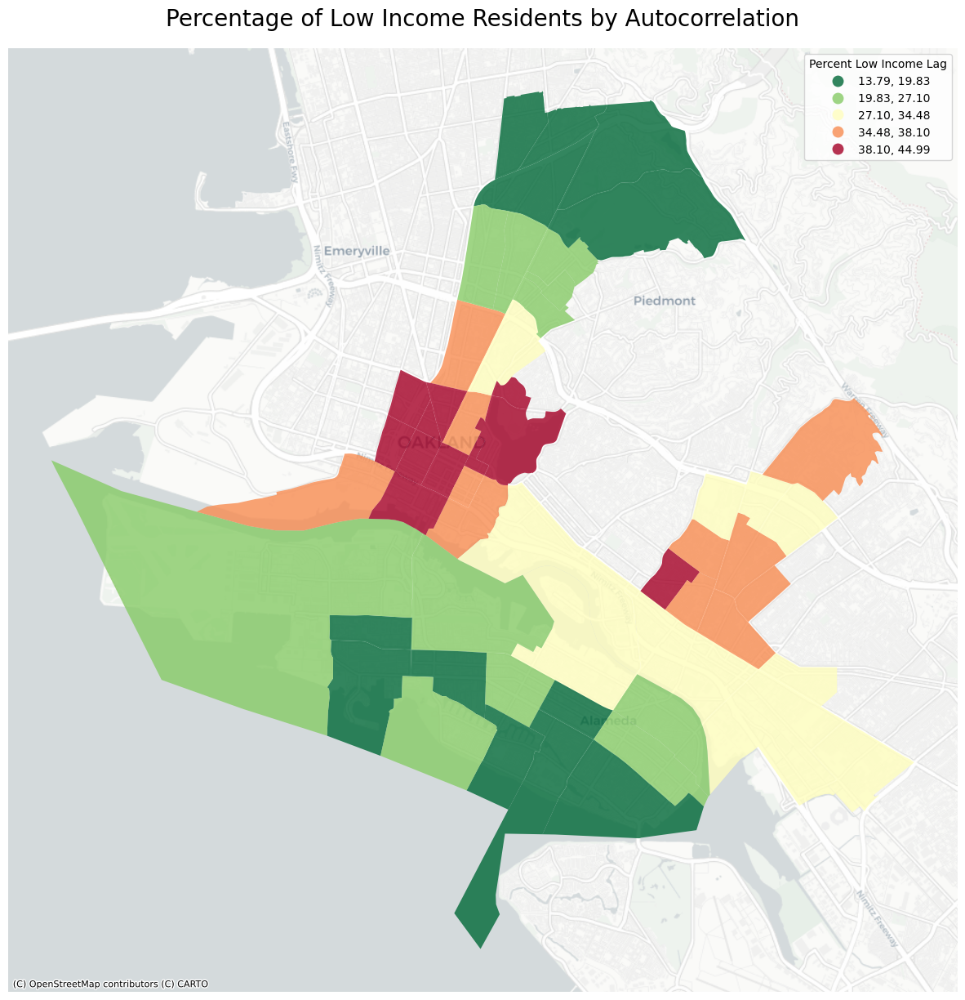

In [29]:
fig, ax = plt.subplots(figsize=(15, 15))


geo_df.plot(ax=ax,
         figsize=(15,15),
         column='PCT_low_income_lag',
         legend=True,
         alpha=0.8,
         cmap='RdYlGn_r',
         scheme='quantiles',
           legend_kwds={
               'loc': 'upper right',
               'bbox_to_anchor':(1,1),
               'title': 'Percent Low Income Lag'
            })

ax.axis('off')
ax.set_title('Percentage of Low Income Residents by Autocorrelation',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [30]:
geo_df['PCT_Take_Transit'] = geo_df['Public Transportation (Includes Taxicab)']/geo_df['Workers 16 years and over']*100

In [31]:
geo_df['PCT_Transit_lag'] = lps.weights.lag_spatial(wq, geo_df['PCT_Take_Transit'])

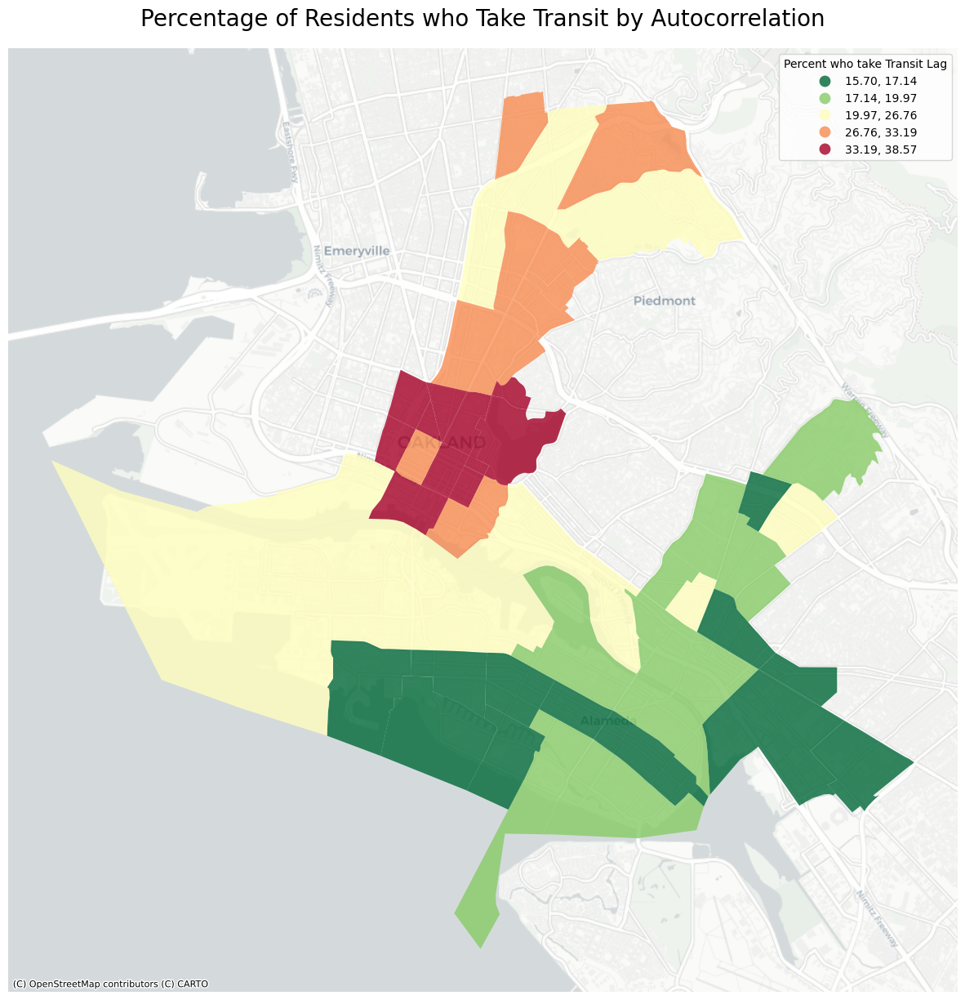

In [32]:
fig, ax = plt.subplots(figsize=(15, 15))


geo_df.plot(ax=ax,
         figsize=(15,15),
         column='PCT_Transit_lag',
         legend=True,
         alpha=0.8,
         cmap='RdYlGn_r',
         scheme='quantiles',
           legend_kwds={
               'loc': 'upper right',
               'bbox_to_anchor':(1,1),
               'title': 'Percent who take Transit Lag'
            })

ax.axis('off')
ax.set_title('Percentage of Residents who Take Transit by Autocorrelation',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [33]:
tracts = gpd.read_file('Alameda_Census_Tracts.geojson', crs='EPSG:4326')

In [34]:
tracts.head()

,statefp10,mtfcc10,name10,intptlat10,awater10,namelsad10,funcstat10,aland10,geoid10,tractce10,intptlon10,countyfp10,geometry
0,06,G5020,4378,+37.6431464,0,Census Tract 4378,S,1276296,06001437800,437800,-122.0686965,001,"MULTIPOLYGON (((-122.07430 37.64984, -122.0742..."
1,06,G5020,4374,+37.6428275,0,Census Tract 4374,S,860214,06001437400,437400,-122.0876478,001,"MULTIPOLYGON (((-122.08755 37.64759, -122.0874..."
2,06,G5020,4058,+37.7939452,0,Census Tract 4058,S,519054,06001405800,405800,-122.2330985,001,"MULTIPOLYGON (((-122.22842 37.79138, -122.2285..."
3,06,G5020,4339,+37.6992653,0,Census Tract 4339,S,816478,06001433900,433900,-122.1135398,001,"MULTIPOLYGON (((-122.10828 37.70002, -122.1079..."
4,06,G5020,4375,+37.6440340,0,Census Tract 4375,S,633478,06001437500,437500,-122.0793899,001,"MULTIPOLYGON (((-122.07998 37.64891, -122.0798..."


In [35]:
df = pd.read_csv('census_tracts_data.csv',
    dtype=
    {
        'Geo_FIPS':str,
        'Geo_STATE':str,
        'Geo_COUNTY': str
    }
)

In [36]:
df.head()

,Geo_FIPS,Geo_QName,Geo_FILEID,Geo_STUSAB,Geo_SUMLEV,Geo_GEOCOMP,Geo_LOGRECNO,Geo_US,Geo_REGION,Geo_DIVISION,...,SE_A09005_008,PCT_SE_A09005_002,PCT_SE_A09005_009,PCT_SE_A09005_010,PCT_SE_A09005_003,PCT_SE_A09005_004,PCT_SE_A09005_005,PCT_SE_A09005_006,PCT_SE_A09005_007,PCT_SE_A09005_008
0,6001400200,"Census Tract 4002, Alameda County, California",ACSSF,ca,140,0,2819,NaN,NaN,NaN,...,371,30.57,25.09,5.47,29.01,0.91,3.01,2.65,0.00,33.85
1,6001400300,"Census Tract 4003, Alameda County, California",ACSSF,ca,140,0,2820,NaN,NaN,NaN,...,929,34.90,30.43,4.47,29.01,1.40,3.31,3.13,0.00,28.25
2,6001400400,"Census Tract 4004, Alameda County, California",ACSSF,ca,140,0,2821,NaN,NaN,NaN,...,596,44.04,36.61,7.43,19.35,0.62,6.54,5.38,1.01,23.07
3,6001401100,"Census Tract 4011, Alameda County, California",ACSSF,ca,140,0,2828,NaN,NaN,NaN,...,540,31.96,29.38,2.58,42.16,0.77,3.78,4.33,0.43,16.58
4,6001401200,"Census Tract 4012, Alameda County, California",ACSSF,ca,140,0,2829,NaN,NaN,NaN,...,384,40.65,34.83,5.82,27.94,0.00,5.13,4.22,1.55,20.51


In [37]:
df['Geo_FIPS'] = df['Geo_FIPS'].apply(lambda x: x.zfill(11))

In [38]:
df.head()

,Geo_FIPS,Geo_QName,Geo_FILEID,Geo_STUSAB,Geo_SUMLEV,Geo_GEOCOMP,Geo_LOGRECNO,Geo_US,Geo_REGION,Geo_DIVISION,...,SE_A09005_008,PCT_SE_A09005_002,PCT_SE_A09005_009,PCT_SE_A09005_010,PCT_SE_A09005_003,PCT_SE_A09005_004,PCT_SE_A09005_005,PCT_SE_A09005_006,PCT_SE_A09005_007,PCT_SE_A09005_008
0,06001400200,"Census Tract 4002, Alameda County, California",ACSSF,ca,140,0,2819,NaN,NaN,NaN,...,371,30.57,25.09,5.47,29.01,0.91,3.01,2.65,0.00,33.85
1,06001400300,"Census Tract 4003, Alameda County, California",ACSSF,ca,140,0,2820,NaN,NaN,NaN,...,929,34.90,30.43,4.47,29.01,1.40,3.31,3.13,0.00,28.25
2,06001400400,"Census Tract 4004, Alameda County, California",ACSSF,ca,140,0,2821,NaN,NaN,NaN,...,596,44.04,36.61,7.43,19.35,0.62,6.54,5.38,1.01,23.07
3,06001401100,"Census Tract 4011, Alameda County, California",ACSSF,ca,140,0,2828,NaN,NaN,NaN,...,540,31.96,29.38,2.58,42.16,0.77,3.78,4.33,0.43,16.58
4,06001401200,"Census Tract 4012, Alameda County, California",ACSSF,ca,140,0,2829,NaN,NaN,NaN,...,384,40.65,34.83,5.82,27.94,0.00,5.13,4.22,1.55,20.51


In [39]:
df = df.dropna(axis=1,how="all")

In [40]:
columns_to_keep = ['Geo_FIPS',
                   'SE_A03001_001',
                  'SE_A03001_002',
                  'SE_A03001_003',
                  'SE_A03001_005',
                  'SE_A01001_011',
                  'SE_A01001_012',
                  'SE_A01001_013',
                  'SE_A14001_001',
                  'SE_A14001_002',
                  'SE_A14001_003',
                  'SE_A14001_004',
                  'SE_A14001_005',
                  'SE_A14001_006',
                  'SE_A14001_007',
                  'SE_A14001_008',
                  'SE_A09005_001',
                  'SE_A09005_003']

df2 = df[columns_to_keep]

In [41]:
dataset2.columns = ['FIPS',
'Total Population','White Alone','Black or African American Alone',
                   'Asian Alone', '65 to 74 years', '75 to 84 years', '85 years and above',
                   'Households','Less than $10,000', '$10,000 to $14,999', '$15,000 to $19,999',
                   '$20,000 to $24,999', '$25,000 to 29,999','$30,000 to $34,999','$35,000 to $39,999',
                   'Workers 16 years and over','Public Transportation (Includes Taxicab)']

In [42]:
tracts = tracts.loc[(tracts['namelsad10'] == 'Census Tract 4026') | (tracts['namelsad10'] == 'Census Tract 4027') |
                    (tracts['namelsad10'] == 'Census Tract 4028.01')|(tracts['namelsad10'] == 'Census Tract 4028.02')|
                   (tracts['namelsad10'] == 'Census Tract 4029')|(tracts['namelsad10'] == 'Census Tract 4030')|
                   (tracts['namelsad10'] == 'Census Tract 4031')| (tracts['namelsad10'] == 'Census Tract 4033.01') |
                   (tracts['namelsad10'] == 'Census Tract 4033.02')| (tracts['namelsad10'] == 'Census Tract 4034.01')|
                   (tracts['namelsad10'] == 'Census Tract 4034.02')|(tracts['namelsad10'] == 'Census Tract 4060')|
                   (tracts['namelsad10'] == 'Census Tract 4061')|(tracts['namelsad10'] == 'Census Tract 4062.02')|
                   (tracts['namelsad10'] == 'Census Tract 4072')|(tracts['namelsad10'] == 'Census Tract 4073')|
                   (tracts['namelsad10'] == 'Census Tract 4074')|(tracts['namelsad10'] == 'Census Tract 4088')|
                   (tracts['namelsad10'] == 'Census Tract 4271')|(tracts['namelsad10'] == 'Census Tract 4272')
                   |(tracts['namelsad10'] == 'Census Tract 4273')|(tracts['namelsad10'] == 'Census Tract 4276')|
                   (tracts['namelsad10'] == 'Census Tract 4278')|(tracts['namelsad10'] == 'Census Tract 4279')|
                   (tracts['namelsad10'] == 'Census Tract 4280')|(tracts['namelsad10'] == 'Census Tract 4281')|
                   (tracts['namelsad10'] == 'Census Tract 4287')|(tracts['namelsad10'] == 'Census Tract 9832')|
                    (tracts['namelsad10'] == 'Census Tract 4002')|(tracts['namelsad10'] == 'Census Tract 4003')|
                    (tracts['namelsad10'] == 'Census Tract 4011')|(tracts['namelsad10'] == 'Census Tract 4012')|
                    (tracts['namelsad10'] == 'Census Tract 4013')|(tracts['namelsad10'] == 'Census Tract 4035.01')|
                    (tracts['namelsad10'] == 'Census Tract 4035.02')|(tracts['namelsad10'] == 'Census Tract 4037.01')|
                    (tracts['namelsad10'] == 'Census Tract 4040')|(tracts['namelsad10'] == 'Census Tract 4041.01')|
                    (tracts['namelsad10'] == 'Census Tract 4041.02')|(tracts['namelsad10'] == 'Census Tract 4042')|
                    (tracts['namelsad10'] == 'Census Tract 4043')|(tracts['namelsad10'] == 'Census Tract 4287')|
                    (tracts['namelsad10'] == 'Census Tract 4062.01')|(tracts['namelsad10'] == 'Census Tract 4063')|
                    (tracts['namelsad10'] == 'Census Tract 4064')|(tracts['namelsad10'] == 'Census Tract 4065')|
                    (tracts['namelsad10'] == 'Census Tract 4066.01')|(tracts['namelsad10'] == 'Census Tract 4066.02')|
                    (tracts['namelsad10'] == 'Census Tract 4067')|(tracts['namelsad10'] == 'Census Tract 4071.01')|
                    (tracts['namelsad10'] == 'Census Tract 4287')|(tracts['namelsad10'] == 'Census Tract 4284')|
                    (tracts['namelsad10'] == 'Census Tract 4285')|(tracts['namelsad10'] == 'Census Tract 4286')|
                    (tracts['namelsad10'] == 'Census Tract 9820')]

In [43]:
columns_to_keep = ['geoid10',
                   'geometry']

tracts2 = tracts[columns_to_keep]

In [44]:
tracts2.columns = ['FIPS',
'geometry']

In [45]:
tracts2.head()

,FIPS,geometry
15,06001402900,"MULTIPOLYGON (((-122.26545 37.80634, -122.2652..."
17,06001407300,"MULTIPOLYGON (((-122.20336 37.76244, -122.2049..."
18,06001404102,"MULTIPOLYGON (((-122.25604 37.82734, -122.2565..."
30,06001404300,"MULTIPOLYGON (((-122.24355 37.84877, -122.2435..."
50,06001403000,"MULTIPOLYGON (((-122.27135 37.79697, -122.2714..."


<AxesSubplot: >

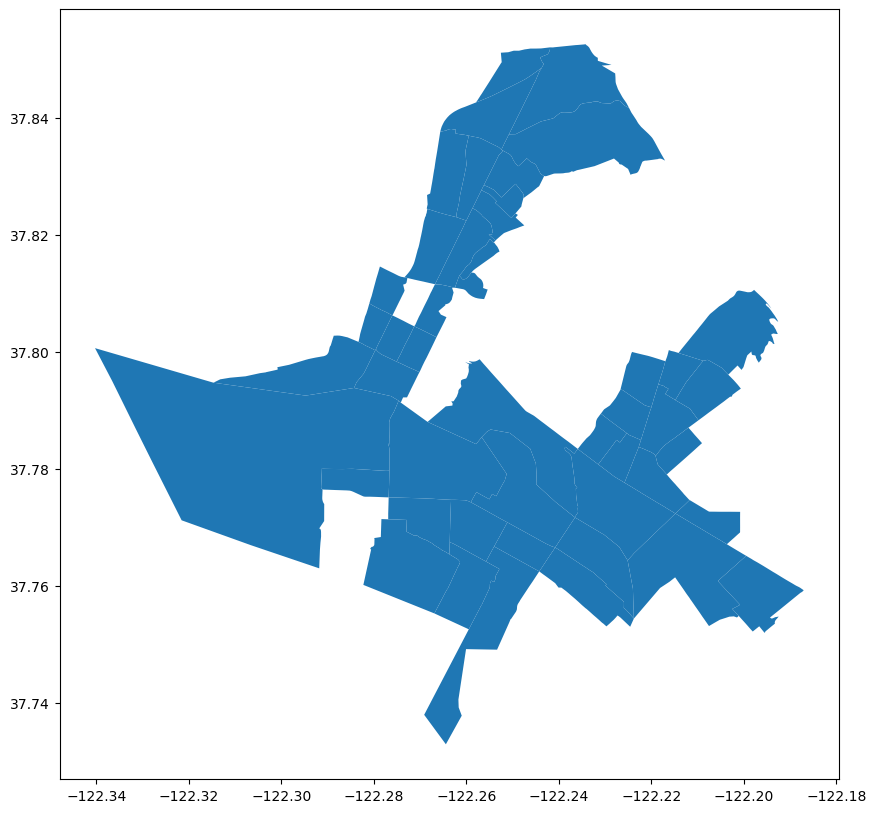

In [46]:
tracts2.plot(figsize=(12,10))

In [50]:
bus=gpd.read_file('Archive.zip')

In [51]:
bus.to_crs(4326)

,DIRCDESC,PUB_RTE,geometry
0,Eastbound,19,"MULTILINESTRING ((-122.22428 37.77403, -122.22..."
1,Westbound,19,"MULTILINESTRING ((-122.20449 37.76143, -122.20..."
2,Eastbound,20,"MULTILINESTRING ((-122.25025 37.75738, -122.25..."
3,Westbound,20,"MULTILINESTRING ((-122.24954 37.75703, -122.24..."
4,Northbound,51A,"LINESTRING (-122.22469 37.77492, -122.22479 37..."
5,Southbound,51A,"LINESTRING (-122.25179 37.84456, -122.25179 37..."


In [52]:
geo_df.dtypes

FIPS                                           int64
Total Population                               int64
White Alone                                    int64
Black or African American Alone                int64
Asian Alone                                    int64
65 to 74 years                                 int64
75 to 84 years                                 int64
85 years and above                             int64
Households                                     int64
Less than $10,000                              int64
$10,000 to $14,999                             int64
$15,000 to $19,999                             int64
$20,000 to $24,999                             int64
$25,000 to 29,999                              int64
$30,000 to $34,999                             int64
$35,000 to $39,999                             int64
Workers 16 years and over                      int64
Public Transportation (Includes Taxicab)       int64
geometry                                    ge

In [53]:
geo_df.crs

In [54]:
geo_df.head()

,FIPS,Total Population,White Alone,Black or African American Alone,Asian Alone,65 to 74 years,75 to 84 years,85 years and above,Households,"Less than $10,000",...,PCT_Seniors_lag,PCT_Black,PCT_Black_lag,PCT_Asian,PCT_Asian_lag,Low_Income,PCT_low_income,PCT_low_income_lag,PCT_Take_Transit,PCT_Transit_lag
0,6001400200,2038,1498,48,197,294,152,28,868,0,...,16.614540,2.355250,8.201089,9.666340,12.715852,29,3.341014,15.430493,29.014599,25.684838
1,6001400300,5449,3410,530,640,548,217,208,2548,78,...,17.289741,9.726555,7.279675,11.745274,12.455985,420,16.483516,13.787680,29.005777,25.685941
2,6001400400,4384,3061,367,356,346,121,65,1826,32,...,18.004922,8.371350,7.449076,8.120438,12.909090,230,12.595838,14.273640,19.349845,26.892932
3,6001401100,5204,2441,933,914,256,43,38,2428,174,...,16.664964,17.928517,14.197711,17.563413,14.691755,440,18.121911,24.160210,42.155358,26.755799
4,6001401200,2800,1796,286,312,138,79,24,1360,26,...,16.398545,10.214286,15.161990,11.142857,15.494324,247,18.161765,24.155229,27.938034,28.532965


In [55]:
geo_df.crs = "EPSG:3857"
#geo_df = geo_df.to_crs(3857)

NameError: name 'gdf_bg' is not defined

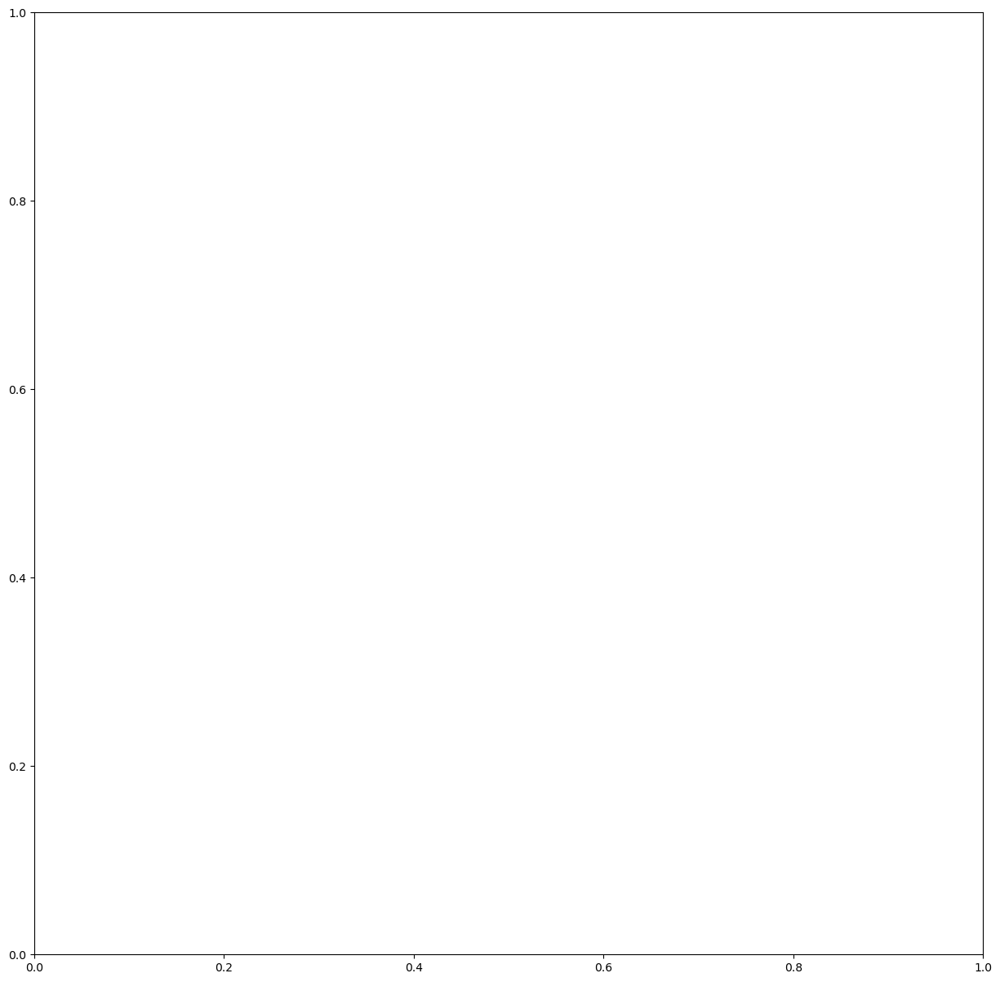

In [56]:
fig,ax = plt.subplots(figsize=(15,15))

gdf_bg.plot(ax=ax,
        column='arrests_per_1000', # this defines the field to "choropleth"
        legend=True,
        alpha=0.8,
        cmap='RdYlGn_r', # the "_r" reverses the color
        scheme='quantiles')

ax.axis('off')
ax.set_title('2022 July to January 2023 arrests per 1000 people',fontsize=18,pad=20)
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [57]:
geo_df.head()

,FIPS,Total Population,White Alone,Black or African American Alone,Asian Alone,65 to 74 years,75 to 84 years,85 years and above,Households,"Less than $10,000",...,PCT_Seniors_lag,PCT_Black,PCT_Black_lag,PCT_Asian,PCT_Asian_lag,Low_Income,PCT_low_income,PCT_low_income_lag,PCT_Take_Transit,PCT_Transit_lag
0,6001400200,2038,1498,48,197,294,152,28,868,0,...,16.614540,2.355250,8.201089,9.666340,12.715852,29,3.341014,15.430493,29.014599,25.684838
1,6001400300,5449,3410,530,640,548,217,208,2548,78,...,17.289741,9.726555,7.279675,11.745274,12.455985,420,16.483516,13.787680,29.005777,25.685941
2,6001400400,4384,3061,367,356,346,121,65,1826,32,...,18.004922,8.371350,7.449076,8.120438,12.909090,230,12.595838,14.273640,19.349845,26.892932
3,6001401100,5204,2441,933,914,256,43,38,2428,174,...,16.664964,17.928517,14.197711,17.563413,14.691755,440,18.121911,24.160210,42.155358,26.755799
4,6001401200,2800,1796,286,312,138,79,24,1360,26,...,16.398545,10.214286,15.161990,11.142857,15.494324,247,18.161765,24.155229,27.938034,28.532965


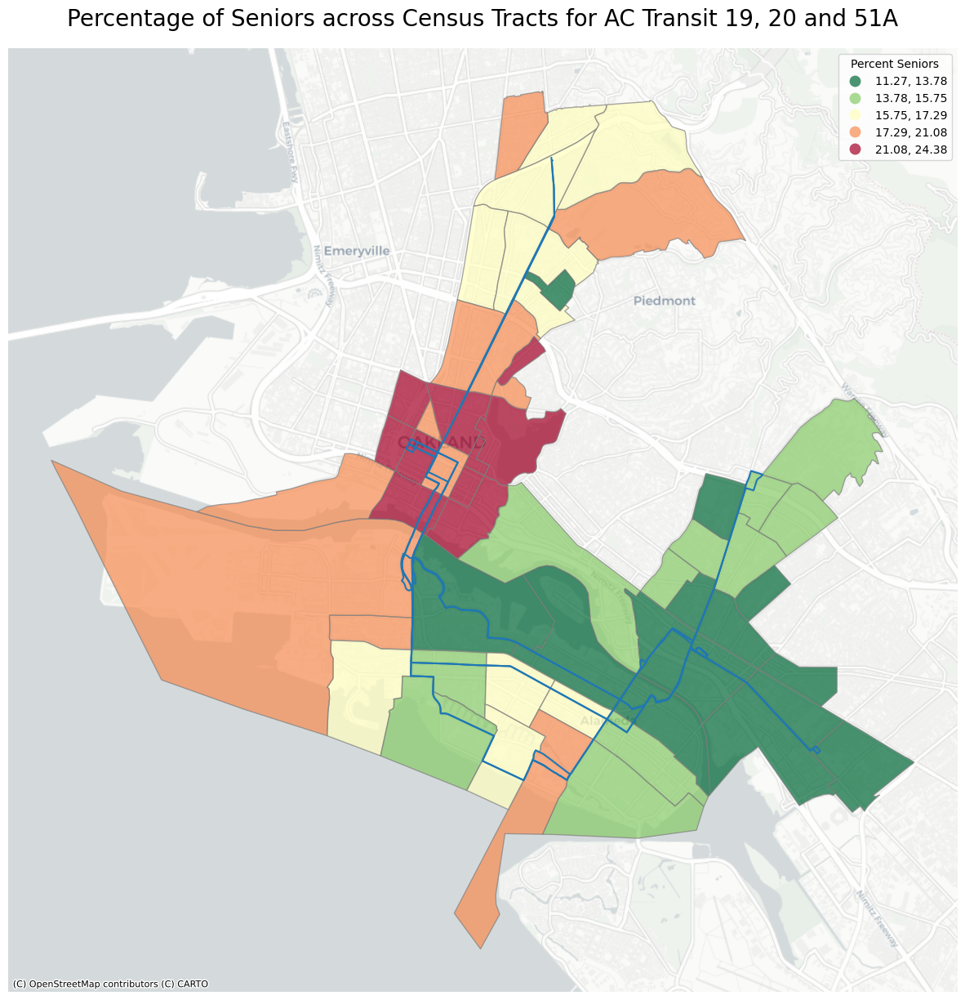

In [77]:
fig, ax = plt.subplots(figsize=(15, 15))


geo_df.plot(ax=ax,
        column='PCT_Seniors_lag',
        scheme='quantiles',
        cmap='RdYlGn_r',
        legend=True,
        edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent Seniors'
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Seniors across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

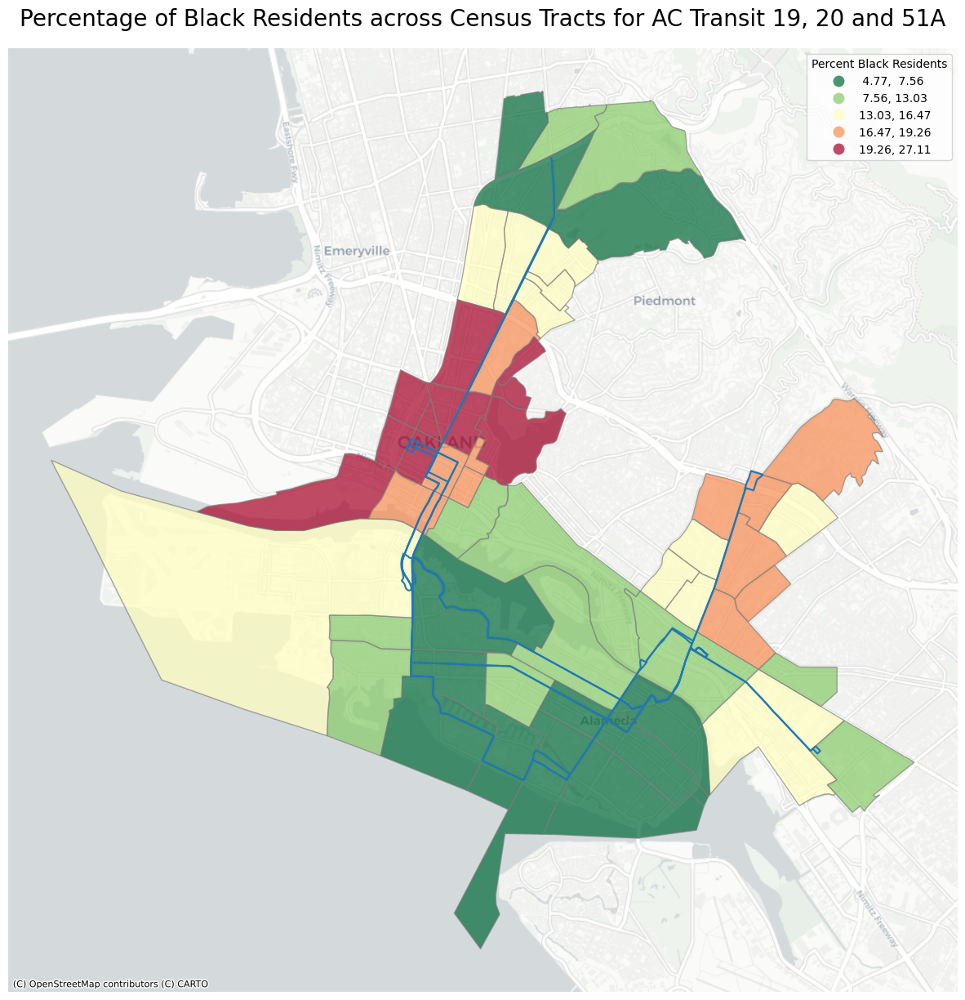

In [76]:
fig, ax = plt.subplots(figsize=(15, 15))


geo_df.plot(ax=ax,
        column='PCT_Black_lag',
        scheme='quantiles',
        cmap='RdYlGn_r',
        legend=True,
        edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent Black Residents'
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Black Residents across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

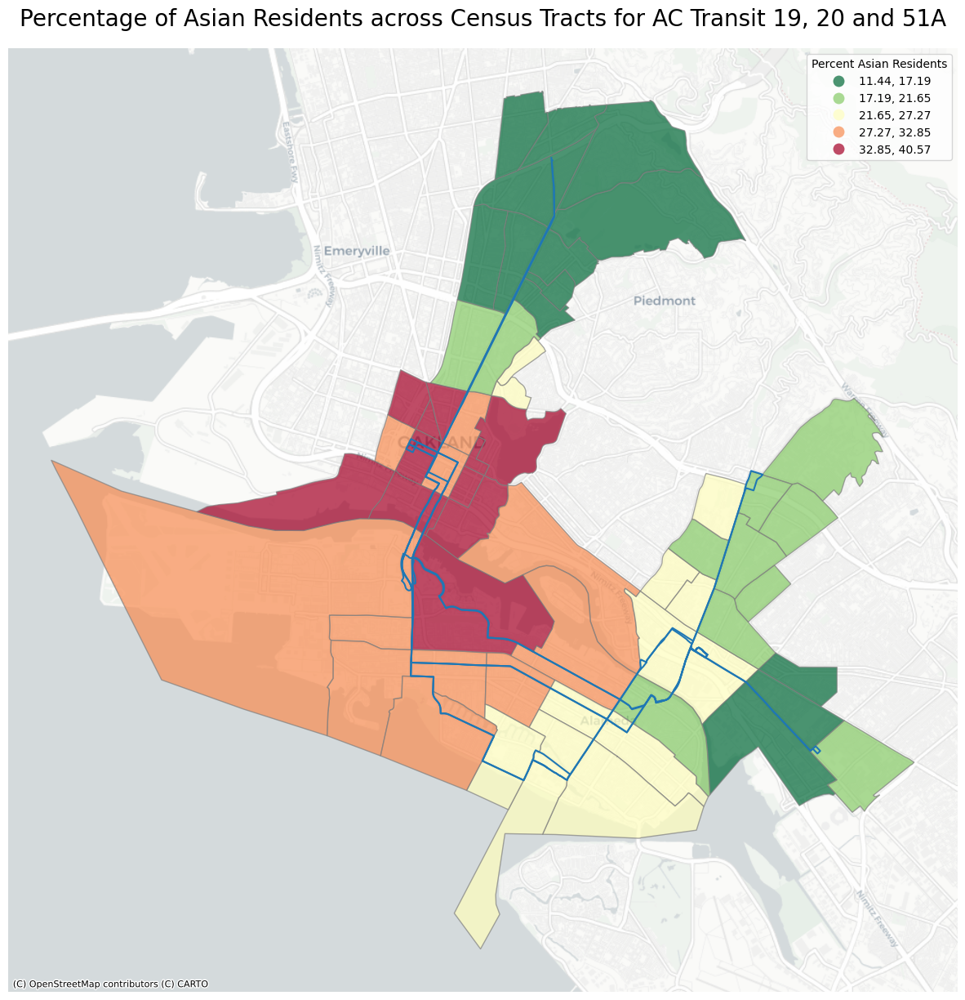

In [75]:
fig, ax = plt.subplots(figsize=(15, 15))


geo_df.plot(ax=ax,
        column='PCT_Asian_lag',
        scheme='quantiles',
        cmap='RdYlGn_r',
        legend=True,
        edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent Asian Residents'
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Asian Residents across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

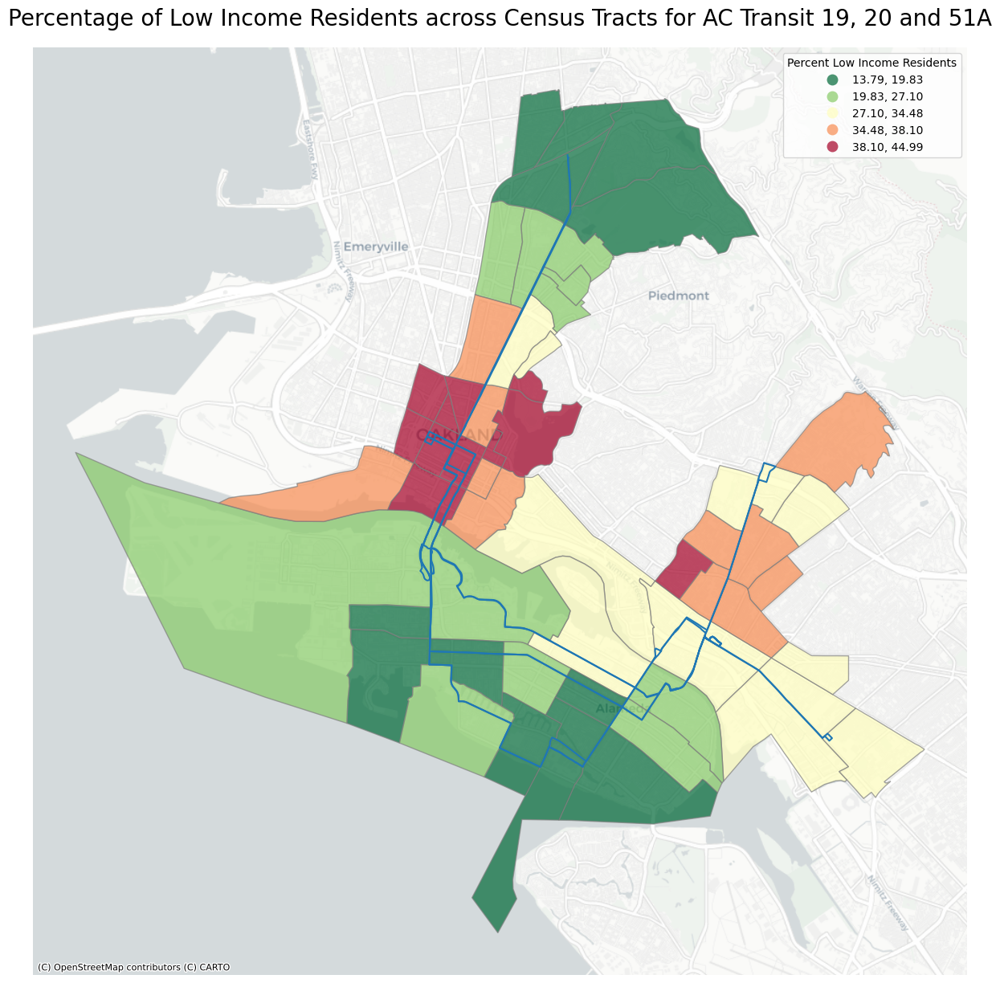

In [74]:
fig, ax = plt.subplots(figsize=(15, 15))


geo_df.plot(ax=ax,
        column='PCT_low_income_lag',
        scheme='quantiles',
        cmap='RdYlGn_r',
        legend=True,
        edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent Low Income Residents'
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Low Income Residents across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

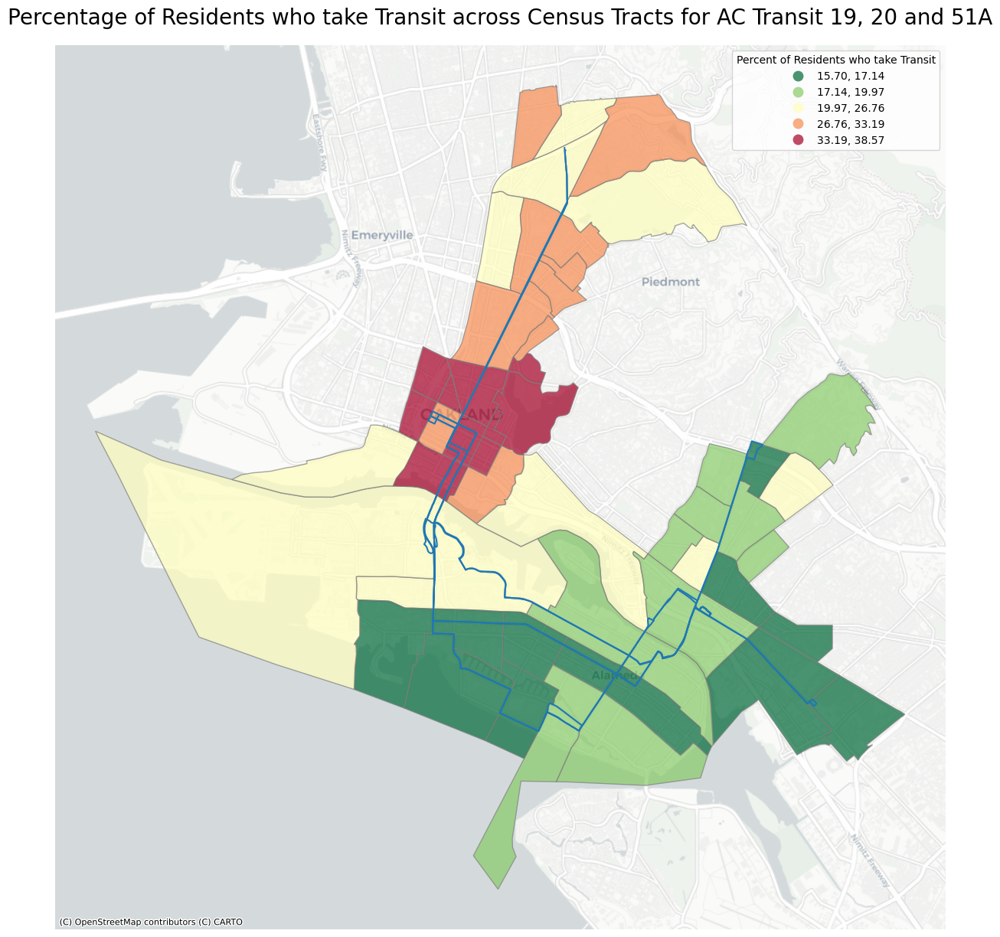

In [73]:
fig, ax = plt.subplots(figsize=(15, 15))


geo_df.plot(ax=ax,
        column='PCT_Transit_lag',
        scheme='quantiles',
        cmap='RdYlGn_r',
        legend=True,
        edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent of Residents who take Transit'
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Residents who take Transit across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


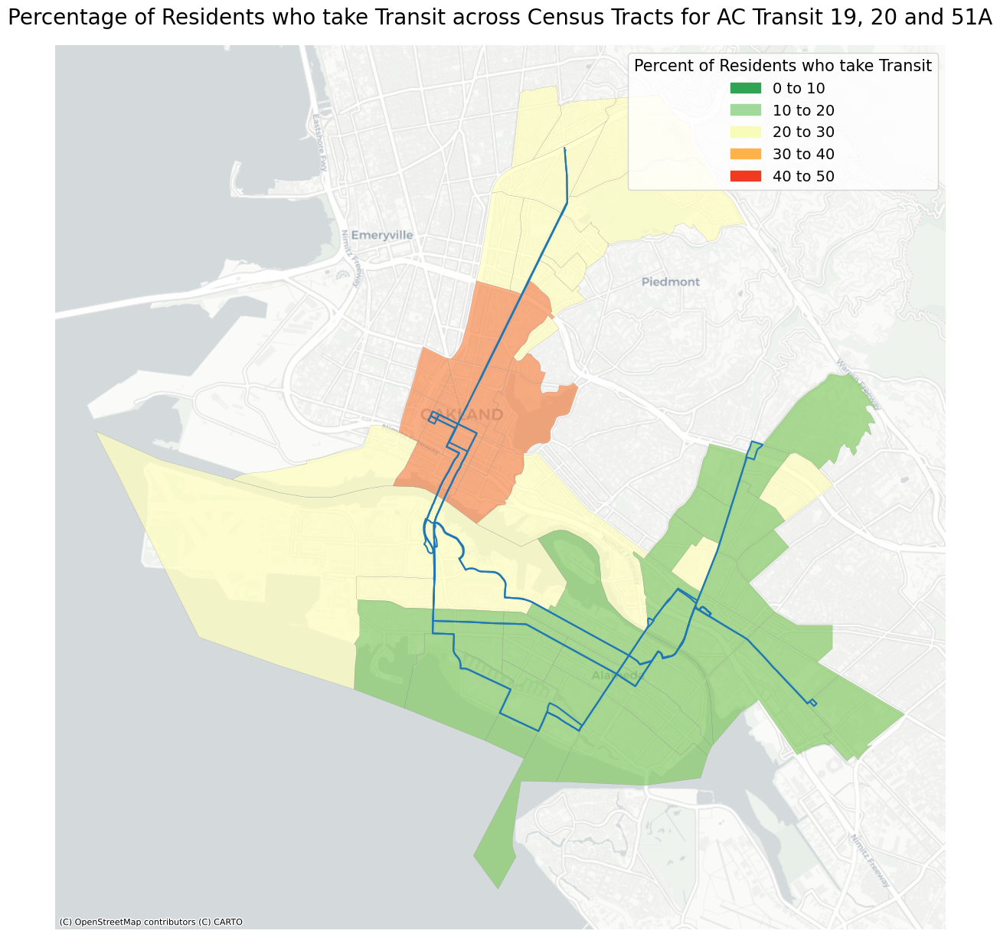

In [92]:
fig, ax = plt.subplots(figsize=(15, 15))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#f03b20', label='40 to 50')


geo_df.plot(ax=ax,
        column='PCT_Transit_lag',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent of Residents who take Transit',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Residents who take Transit across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


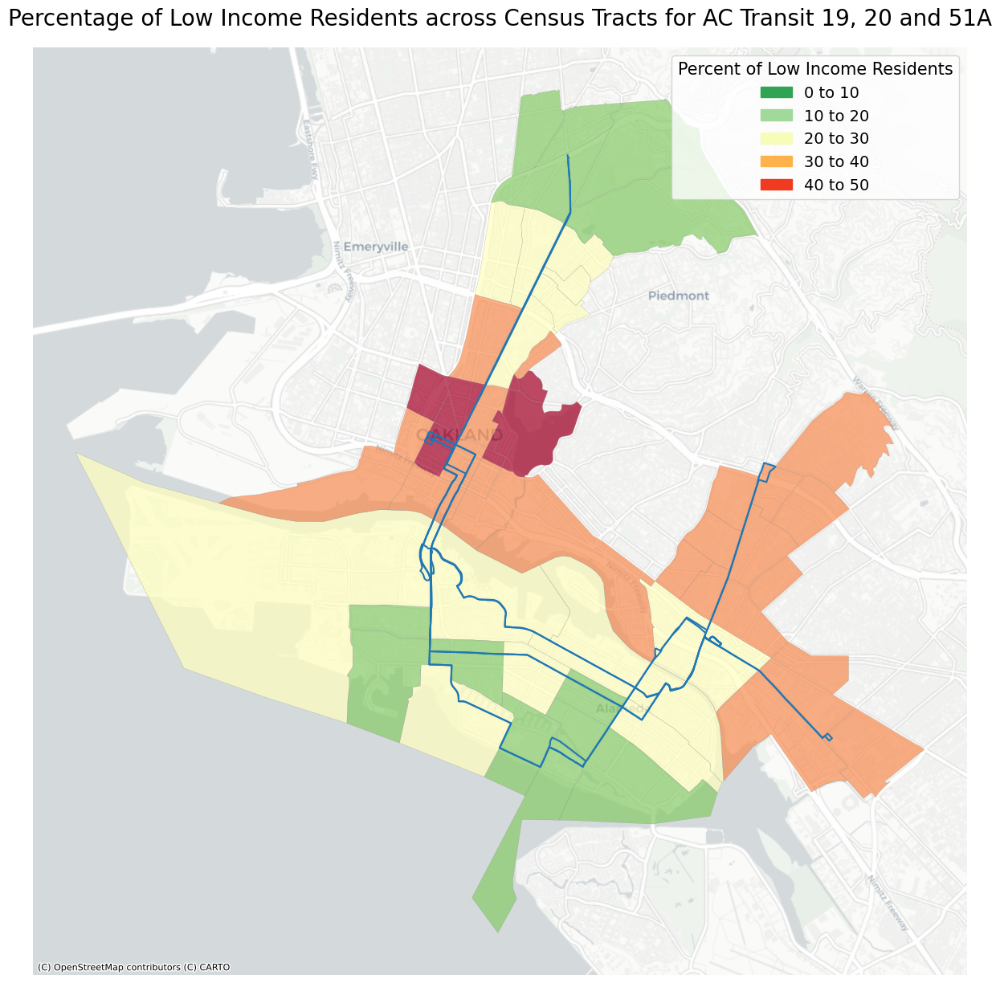

In [93]:
fig, ax = plt.subplots(figsize=(15, 15))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#f03b20', label='40 to 50')


geo_df.plot(ax=ax,
        column='PCT_low_income_lag',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent of Low Income Residents',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Low Income Residents across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


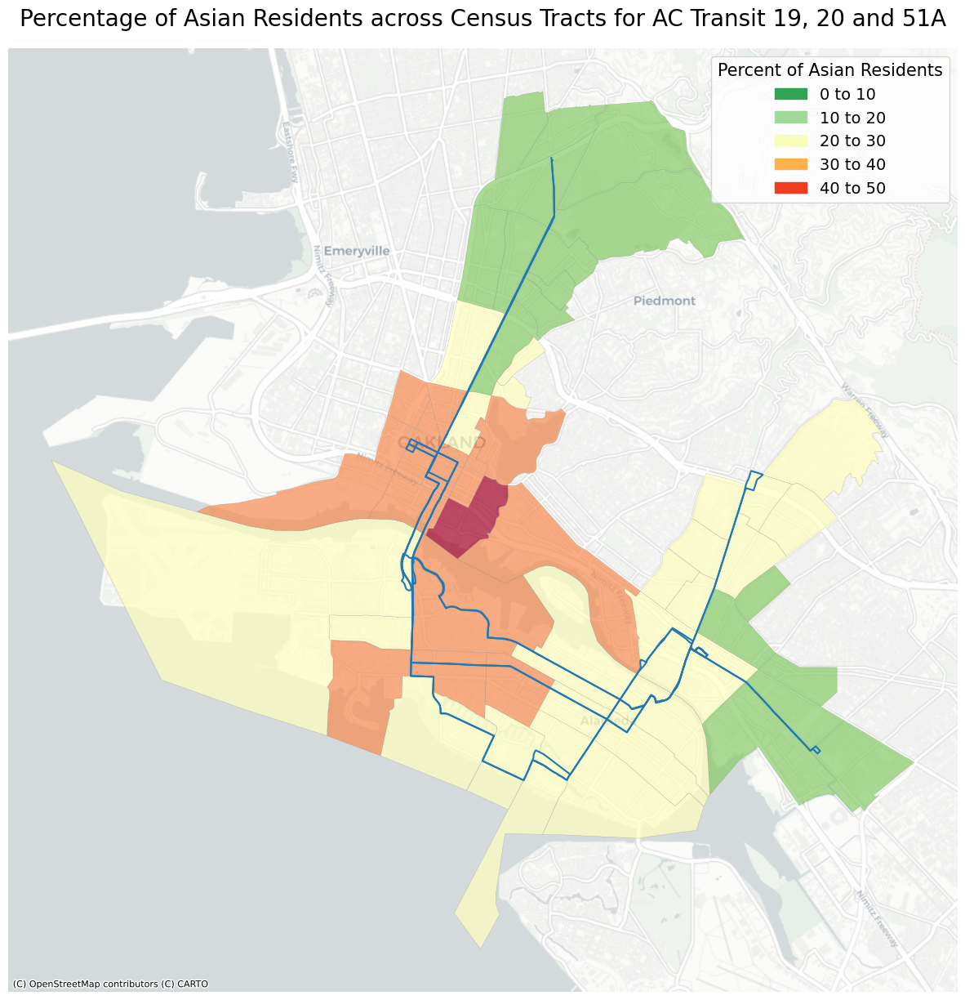

In [94]:
fig, ax = plt.subplots(figsize=(15, 15))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#f03b20', label='40 to 50')


geo_df.plot(ax=ax,
        column='PCT_Asian_lag',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent of Asian Residents',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Asian Residents across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


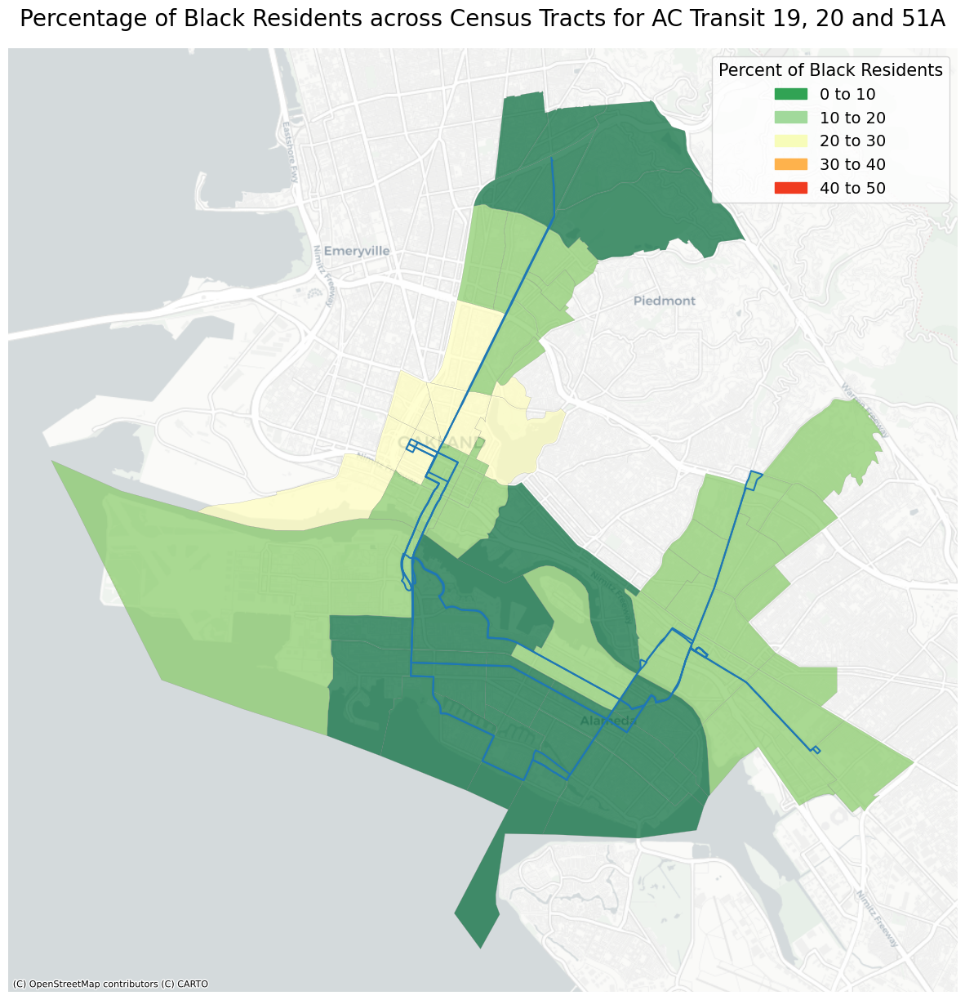

In [95]:
fig, ax = plt.subplots(figsize=(15, 15))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#f03b20', label='40 to 50')


geo_df.plot(ax=ax,
        column='PCT_Black_lag',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent of Black Residents',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Black Residents across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


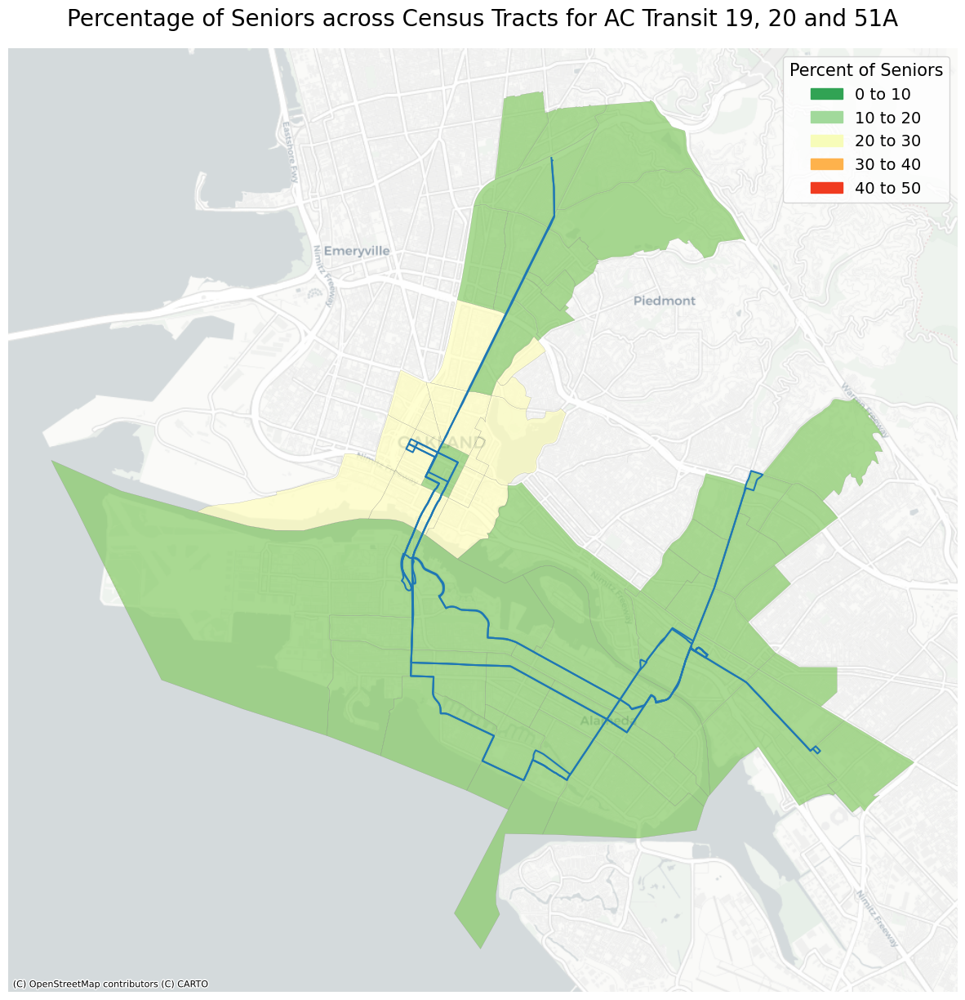

In [96]:
fig, ax = plt.subplots(figsize=(15, 15))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#f03b20', label='40 to 50')


geo_df.plot(ax=ax,
        column='PCT_Seniors_lag',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent of Seniors',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Seniors across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


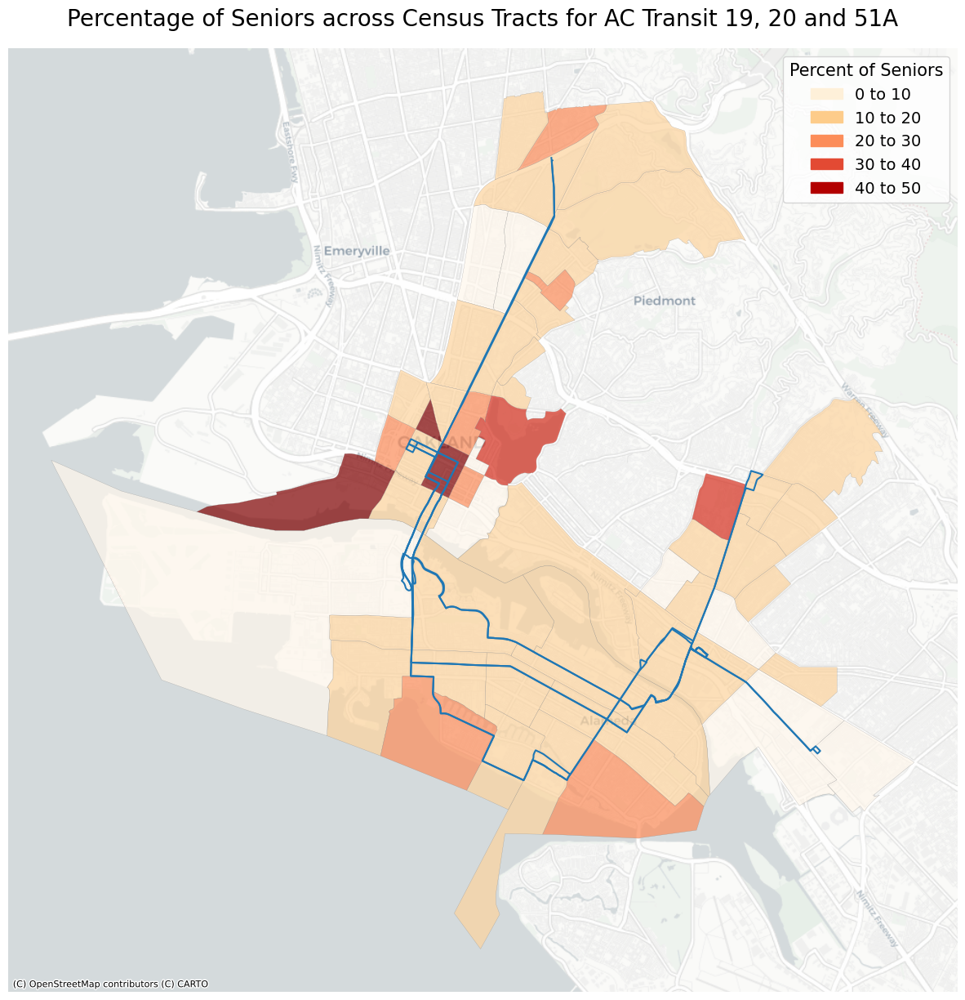

In [85]:
fig, ax = plt.subplots(figsize=(15, 15))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#fef0d9', label='0 to 10') 
bl_2 = mpatches.Patch(color='#fdcc8a', label='10 to 20')
bl_3 = mpatches.Patch(color='#fc8d59', label='20 to 30')
bl_4 = mpatches.Patch(color='#e34a33', label='30 to 40')
bl_5 = mpatches.Patch(color='#b30000', label='40 to 50')


geo_df.plot(ax=ax,
        column='PCT_Seniors',
            legend=True,
        cmap='OrRd',
            scheme='UserDefined',
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent of Seniors',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Seniors across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


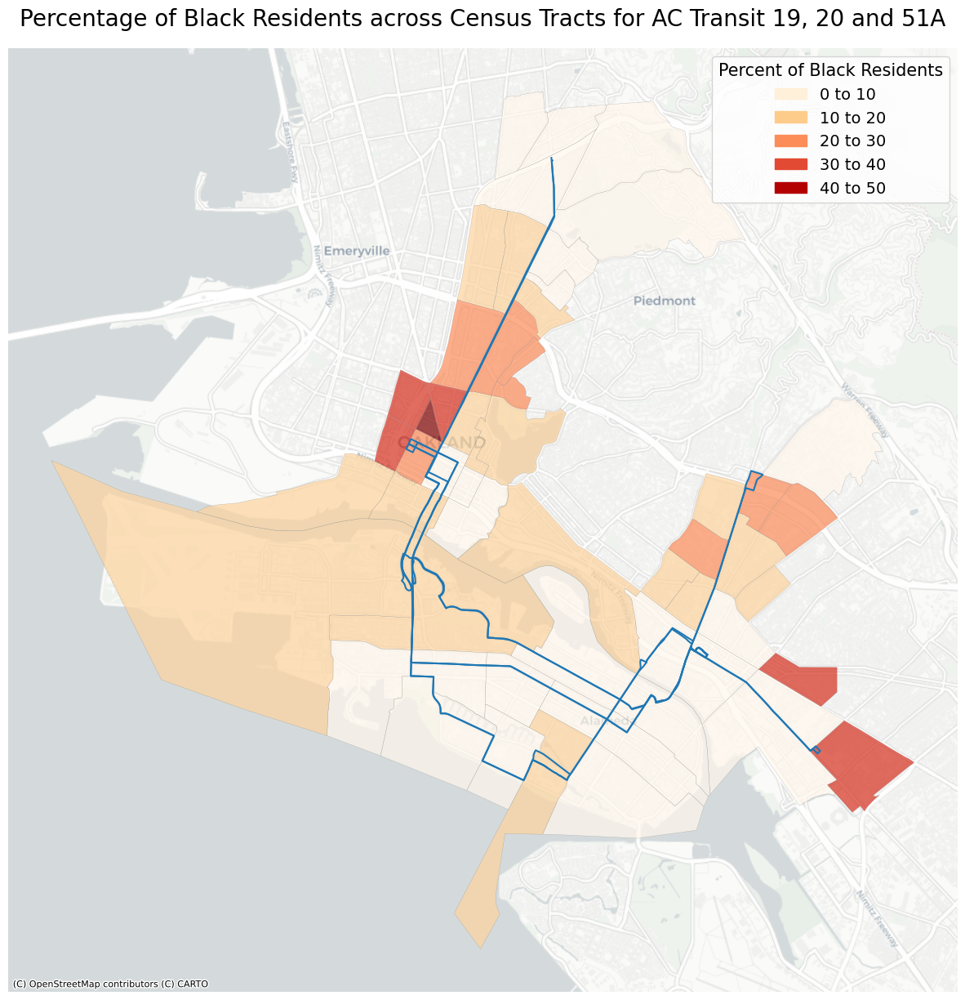

In [90]:
fig, ax = plt.subplots(figsize=(15, 15))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#fef0d9', label='0 to 10') 
bl_2 = mpatches.Patch(color='#fdcc8a', label='10 to 20')
bl_3 = mpatches.Patch(color='#fc8d59', label='20 to 30')
bl_4 = mpatches.Patch(color='#e34a33', label='30 to 40')
bl_5 = mpatches.Patch(color='#b30000', label='40 to 50')


geo_df.plot(ax=ax,
        column='PCT_Black',
            legend=True,
        cmap='OrRd',
            scheme='UserDefined',
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent of Black Residents',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Black Residents across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


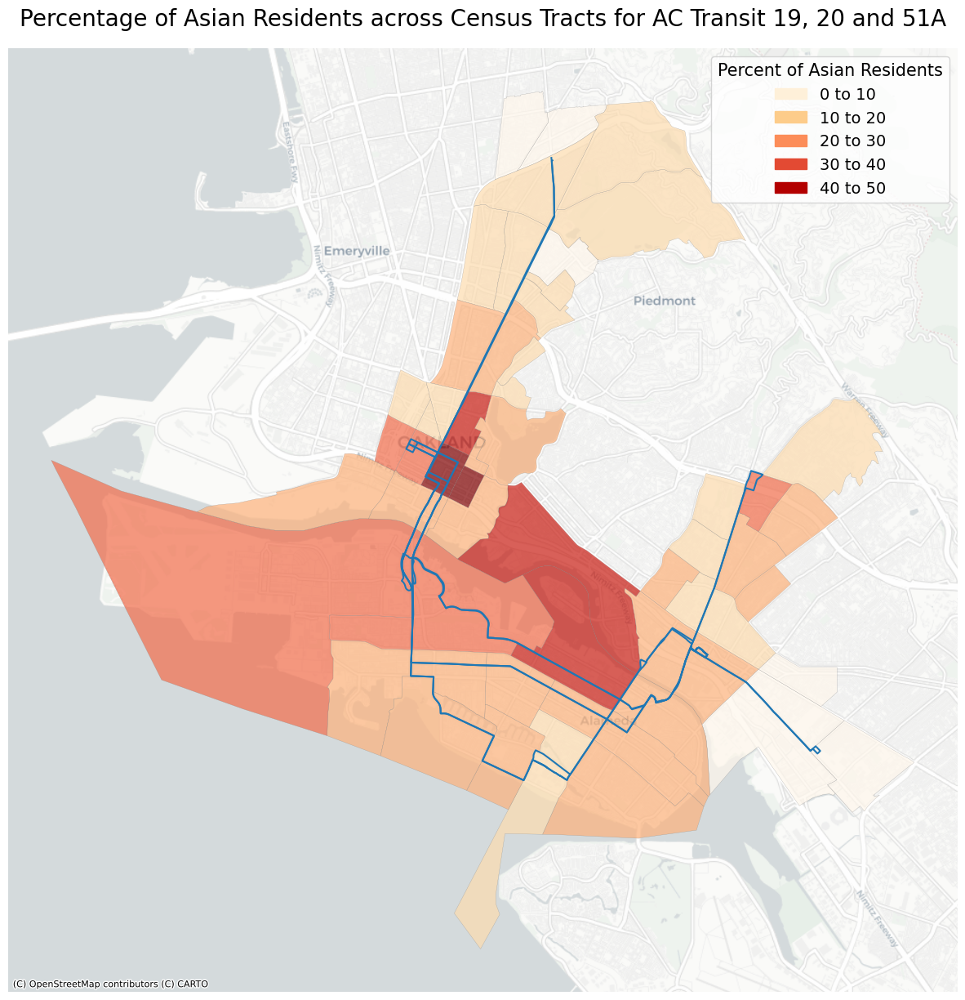

In [89]:
fig, ax = plt.subplots(figsize=(15, 15))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#fef0d9', label='0 to 10') 
bl_2 = mpatches.Patch(color='#fdcc8a', label='10 to 20')
bl_3 = mpatches.Patch(color='#fc8d59', label='20 to 30')
bl_4 = mpatches.Patch(color='#e34a33', label='30 to 40')
bl_5 = mpatches.Patch(color='#b30000', label='40 to 50')


geo_df.plot(ax=ax,
        column='PCT_Asian',
            legend=True,
        cmap='OrRd',
            scheme='UserDefined',
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent of Asian Residents',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Asian Residents across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


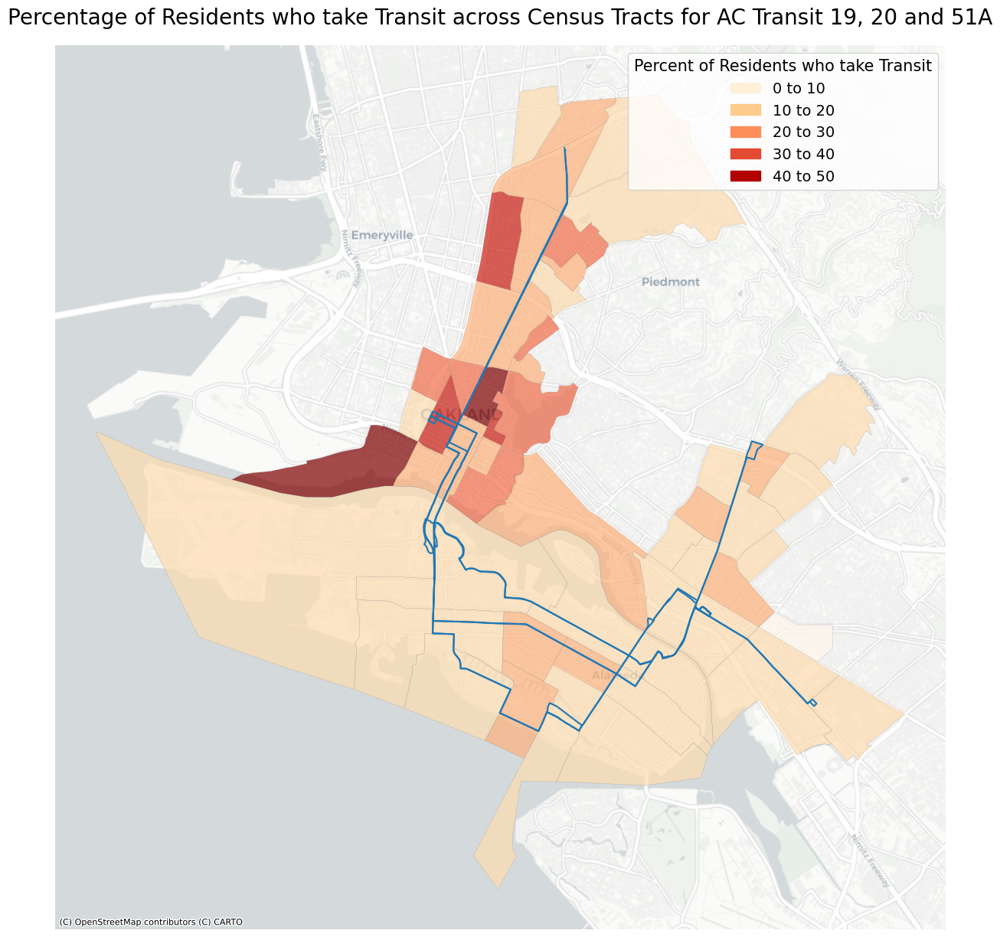

In [91]:
fig, ax = plt.subplots(figsize=(15, 15))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#fef0d9', label='0 to 10') 
bl_2 = mpatches.Patch(color='#fdcc8a', label='10 to 20')
bl_3 = mpatches.Patch(color='#fc8d59', label='20 to 30')
bl_4 = mpatches.Patch(color='#e34a33', label='30 to 40')
bl_5 = mpatches.Patch(color='#b30000', label='40 to 50')


geo_df.plot(ax=ax,
        column='PCT_Take_Transit',
            legend=True,
        cmap='OrRd',
            scheme='UserDefined',
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent of Residents who take Transit',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Residents who take Transit across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


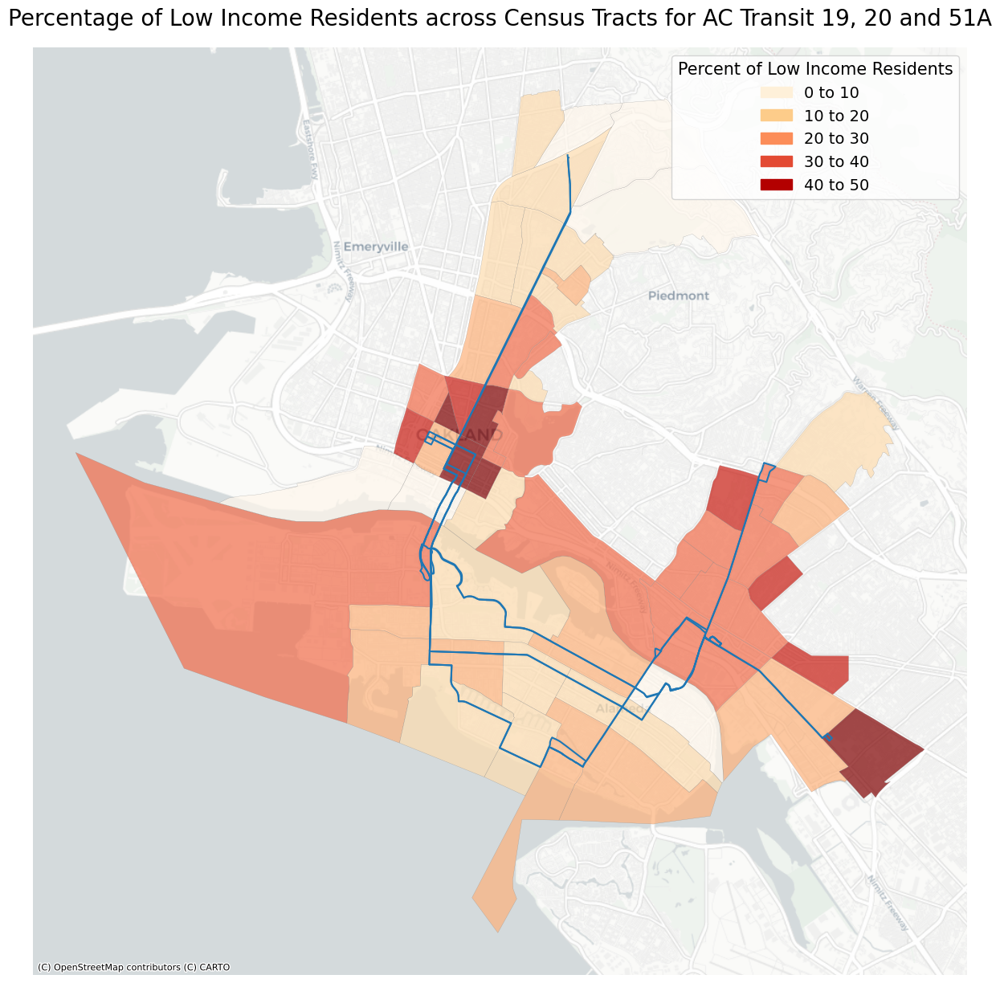

In [88]:
fig, ax = plt.subplots(figsize=(15, 15))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#fef0d9', label='0 to 10') 
bl_2 = mpatches.Patch(color='#fdcc8a', label='10 to 20')
bl_3 = mpatches.Patch(color='#fc8d59', label='20 to 30')
bl_4 = mpatches.Patch(color='#e34a33', label='30 to 40')
bl_5 = mpatches.Patch(color='#b30000', label='40 to 50')


geo_df.plot(ax=ax,
        column='PCT_low_income',
            legend=True,
        cmap='OrRd',
            scheme='UserDefined',
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent of Low Income Residents',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })

bus.to_crs(geo_df.crs).plot(ax=ax)

ax.axis('off')
ax.set_title('Percentage of Low Income Residents across Census Tracts for AC Transit 19, 20 and 51A',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

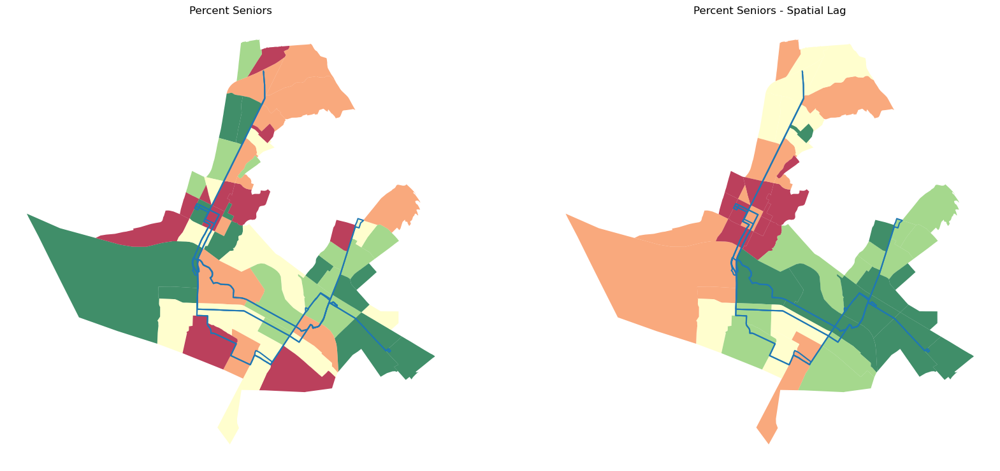

In [105]:
fig, ax = plt.subplots(1, 2, figsize=(20, 12))



geo_df.plot(ax=ax[0], 
         column='PCT_Seniors', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=5, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75, 
           )

bus.to_crs(geo_df.crs).plot(ax=ax[0])

ax[0].axis("off")
ax[0].set_title("Percent Seniors")


geo_df.plot(ax=ax[1], 
         column='PCT_Seniors_lag', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=5, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75
           )

bus.to_crs(geo_df.crs).plot(ax=ax[1])

ax[1].axis("off")
ax[1].set_title("Percent Seniors - Spatial Lag")

plt.show()

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)
/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


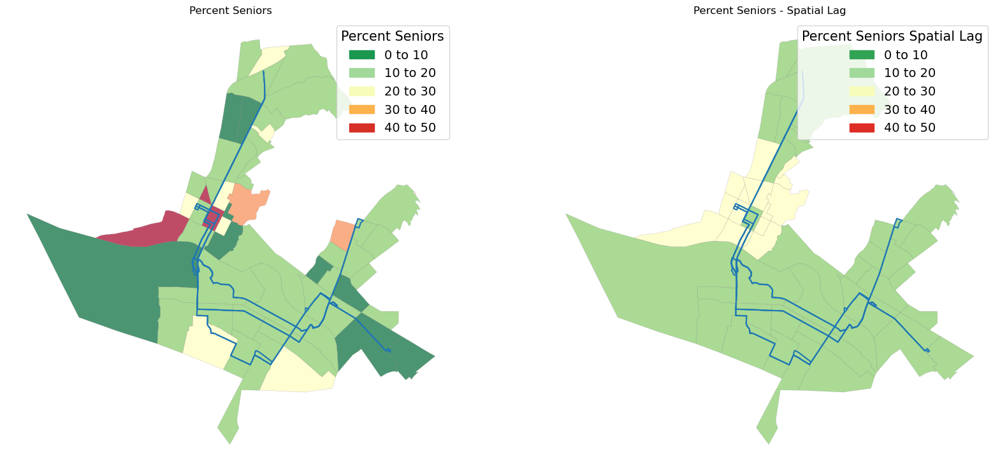

In [115]:
fig, ax = plt.subplots(1, 2, figsize=(20, 12))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#1a9850', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#d73027', label='40 to 50')

geo_df.plot(ax=ax[0],
              column='PCT_Seniors',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
            k=5,
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent Seniors',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })
         

bus.to_crs(geo_df.crs).plot(ax=ax[0])

ax[0].axis("off")
ax[0].set_title("Percent Seniors")

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#de2d26', label='40 to 50')

geo_df.plot(ax=ax[1], 
         column='PCT_Seniors_lag',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
            k=5,
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent Seniors Spatial Lag',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })
         

bus.to_crs(geo_df.crs).plot(ax=ax[1])

ax[1].axis("off")
ax[1].set_title("Percent Seniors - Spatial Lag")

plt.show()

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)
/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


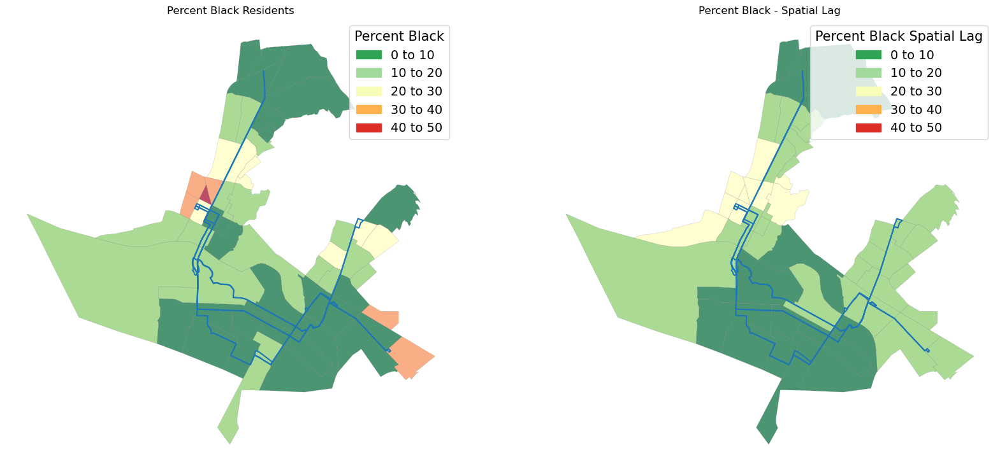

In [110]:
fig, ax = plt.subplots(1, 2, figsize=(20, 12))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#de2d26', label='40 to 50')

geo_df.plot(ax=ax[0],
              column='PCT_Black',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
            k=5,
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent Black',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })
         

bus.to_crs(geo_df.crs).plot(ax=ax[0])

ax[0].axis("off")
ax[0].set_title("Percent Black Residents")

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#de2d26', label='40 to 50')

geo_df.plot(ax=ax[1], 
         column='PCT_Black_lag',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
            k=5,
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent Black Spatial Lag',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })
         

bus.to_crs(geo_df.crs).plot(ax=ax[1])

ax[1].axis("off")
ax[1].set_title("Percent Black - Spatial Lag")

plt.show()

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)
/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


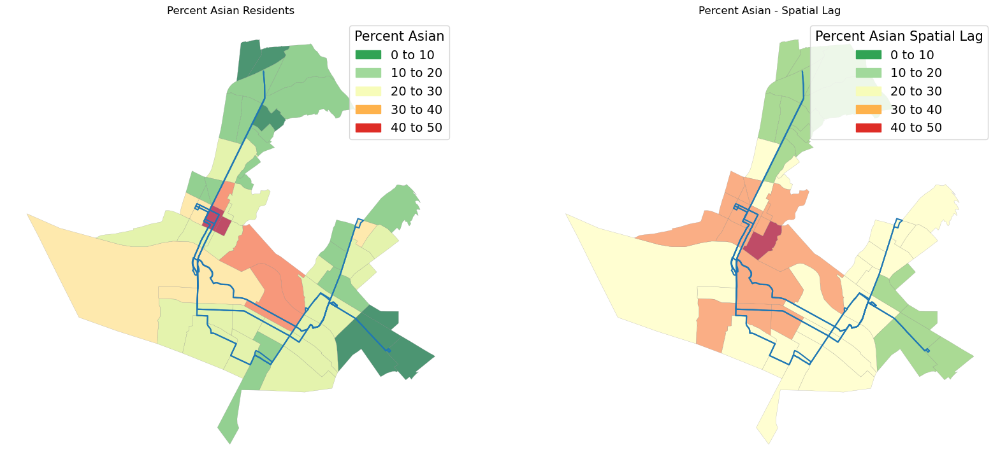

In [112]:
fig, ax = plt.subplots(1, 2, figsize=(20, 12))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#de2d26', label='40 to 50')

geo_df.plot(ax=ax[0],
              column='PCT_Asian',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
            k=5,
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent Asian',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })
         

bus.to_crs(geo_df.crs).plot(ax=ax[0])

ax[0].axis("off")
ax[0].set_title("Percent Asian Residents")

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#de2d26', label='40 to 50')

geo_df.plot(ax=ax[1], 
         column='PCT_Asian_lag',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
            k=5,
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent Asian Spatial Lag',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })
         

bus.to_crs(geo_df.crs).plot(ax=ax[1])

ax[1].axis("off")
ax[1].set_title("Percent Asian - Spatial Lag")

plt.show()

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)
/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


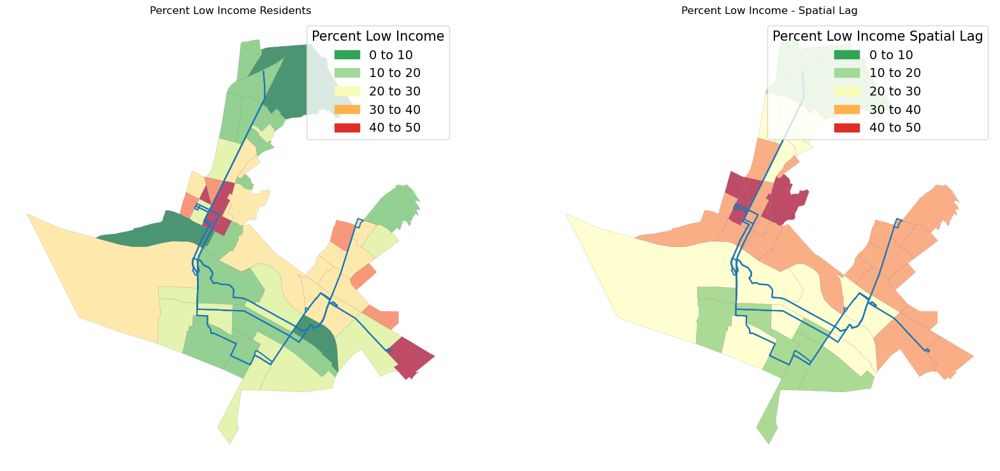

In [113]:
fig, ax = plt.subplots(1, 2, figsize=(20, 12))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#de2d26', label='40 to 50')

geo_df.plot(ax=ax[0],
              column='PCT_low_income',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
            k=5,
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent Low Income',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })
         

bus.to_crs(geo_df.crs).plot(ax=ax[0])

ax[0].axis("off")
ax[0].set_title("Percent Low Income Residents")

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#de2d26', label='40 to 50')

geo_df.plot(ax=ax[1], 
         column='PCT_low_income_lag',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
            k=5,
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent Low Income Spatial Lag',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })
         

bus.to_crs(geo_df.crs).plot(ax=ax[1])

ax[1].axis("off")
ax[1].set_title("Percent Low Income - Spatial Lag")

plt.show()

/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)
/opt/conda/lib/python3.10/site-packages/geopandas/plotting.py:944: UserWarning: You have mixed positional and keyword arguments, some input may be discarded.
  ax.legend(patches, categories, **legend_kwds)


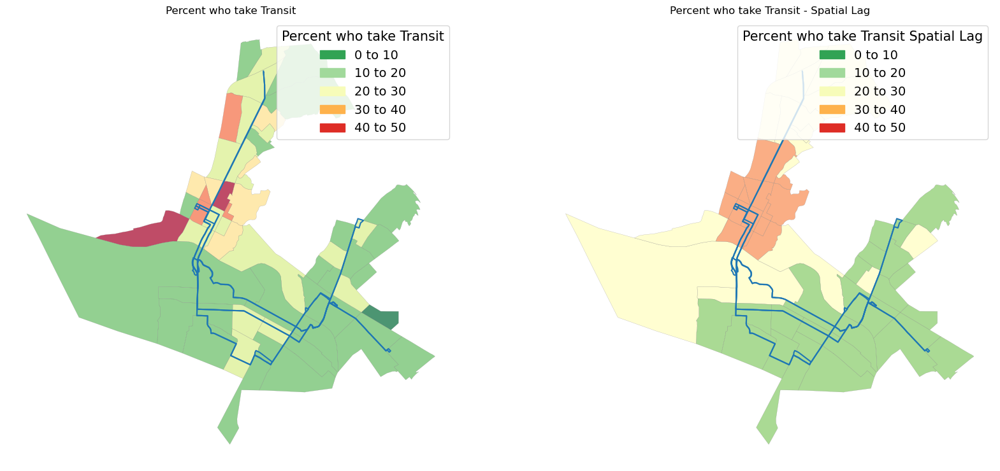

In [114]:
fig, ax = plt.subplots(1, 2, figsize=(20, 12))

bins_bl = [10, 20, 30, 40, 50]

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#de2d26', label='40 to 50')

geo_df.plot(ax=ax[0],
              column='PCT_Take_Transit',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
            k=5,
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent who take Transit',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })
         

bus.to_crs(geo_df.crs).plot(ax=ax[0])

ax[0].axis("off")
ax[0].set_title("Percent who take Transit")

bl_1 = mpatches.Patch(color='#31a354', label='0 to 10') 
bl_2 = mpatches.Patch(color='#a1d99b', label='10 to 20')
bl_3 = mpatches.Patch(color='#f7fcb9', label='20 to 30')
bl_4 = mpatches.Patch(color='#feb24c', label='30 to 40')
bl_5 = mpatches.Patch(color='#de2d26', label='40 to 50')

geo_df.plot(ax=ax[1], 
         column='PCT_Transit_lag',
            legend=True,
        cmap='RdYlGn_r',
            scheme='UserDefined',
            k=5,
        classification_kwds={'bins':bins_bl},
        linewidth=0.2,
            edgecolor='grey',
        alpha=0.7,
        legend_kwds={
           'loc': 'upper right',
           'bbox_to_anchor':(1,1),
           'title': 'Percent who take Transit Spatial Lag',
            'title_fontsize':15,
            'fontsize':14,
            'handles':[bl_1, bl_2, bl_3, bl_4, bl_5]
        })
         

bus.to_crs(geo_df.crs).plot(ax=ax[1])

ax[1].axis("off")
ax[1].set_title("Percent who take Transit - Spatial Lag")

plt.show()

In [ ]:
tracts = gpd.read_file('Alameda_Census_Tracts.geojson', crs='EPSG:4326')

In [ ]:
tracts = tracts.loc[(tracts['namelsad10'] == 'Census Tract 4026') | (tracts['namelsad10'] == 'Census Tract 4027') |
                    (tracts['namelsad10'] == 'Census Tract 4028.01')|(tracts['namelsad10'] == 'Census Tract 4028.02')|
                   (tracts['namelsad10'] == 'Census Tract 4029')|(tracts['namelsad10'] == 'Census Tract 4030')|
                   (tracts['namelsad10'] == 'Census Tract 4031')| (tracts['namelsad10'] == 'Census Tract 4033.01') |
                   (tracts['namelsad10'] == 'Census Tract 4033.02')| (tracts['namelsad10'] == 'Census Tract 4034.01')|
                   (tracts['namelsad10'] == 'Census Tract 4034.02')|(tracts['namelsad10'] == 'Census Tract 4060')|
                   (tracts['namelsad10'] == 'Census Tract 4061')|(tracts['namelsad10'] == 'Census Tract 4062.02')|
                   (tracts['namelsad10'] == 'Census Tract 4072')|(tracts['namelsad10'] == 'Census Tract 4073')|
                   (tracts['namelsad10'] == 'Census Tract 4074')|(tracts['namelsad10'] == 'Census Tract 4088')|
                   (tracts['namelsad10'] == 'Census Tract 4271')|(tracts['namelsad10'] == 'Census Tract 4272')
                   |(tracts['namelsad10'] == 'Census Tract 4273')|(tracts['namelsad10'] == 'Census Tract 4276')|
                   (tracts['namelsad10'] == 'Census Tract 4278')|(tracts['namelsad10'] == 'Census Tract 4279')|
                   (tracts['namelsad10'] == 'Census Tract 4280')|(tracts['namelsad10'] == 'Census Tract 4281')|
                   (tracts['namelsad10'] == 'Census Tract 4287')|(tracts['namelsad10'] == 'Census Tract 9832')|
                    (tracts['namelsad10'] == 'Census Tract 4002')|(tracts['namelsad10'] == 'Census Tract 4003')|
                    (tracts['namelsad10'] == 'Census Tract 4011')|(tracts['namelsad10'] == 'Census Tract 4012')|
                    (tracts['namelsad10'] == 'Census Tract 4013')|(tracts['namelsad10'] == 'Census Tract 4035.01')|
                    (tracts['namelsad10'] == 'Census Tract 4035.02')|(tracts['namelsad10'] == 'Census Tract 4037.01')|
                    (tracts['namelsad10'] == 'Census Tract 4040')|(tracts['namelsad10'] == 'Census Tract 4041.01')|
                    (tracts['namelsad10'] == 'Census Tract 4041.02')|(tracts['namelsad10'] == 'Census Tract 4042')|
                    (tracts['namelsad10'] == 'Census Tract 4043')|(tracts['namelsad10'] == 'Census Tract 4287')|
                    (tracts['namelsad10'] == 'Census Tract 4062.01')|(tracts['namelsad10'] == 'Census Tract 4063')|
                    (tracts['namelsad10'] == 'Census Tract 4064')|(tracts['namelsad10'] == 'Census Tract 4065')|
                    (tracts['namelsad10'] == 'Census Tract 4066.01')|(tracts['namelsad10'] == 'Census Tract 4066.02')|
                    (tracts['namelsad10'] == 'Census Tract 4067')|(tracts['namelsad10'] == 'Census Tract 4071.01')|
                    (tracts['namelsad10'] == 'Census Tract 4287')|(tracts['namelsad10'] == 'Census Tract 4284')|
                    (tracts['namelsad10'] == 'Census Tract 4285')|(tracts['namelsad10'] == 'Census Tract 4286')|
                    (tracts['namelsad10'] == 'Census Tract 9820')|(tracts['namelsad10']=='Census Tract 4277')|
                   (tracts['namelsad10']=='Census Tract 4282')|(tracts['namelsad10']=='Census Tract 4004')]

In [ ]:
tracts.plot()

In [ ]:
columns_to_keep = ['geoid10',
                   'geometry']

tracts2 = tracts[columns_to_keep]

In [ ]:
tracts2.columns = ['FIPS',
'geometry']

In [ ]:
df2.columns = ['FIPS',
'Total Population','White Alone','Black or African American Alone',
                   'Asian Alone', '65 to 74 years', '75 to 84 years', '85 years and above',
                   'Households','Less than $10,000', '$10,000 to $14,999', '$15,000 to $19,999',
                   '$20,000 to $24,999', '$25,000 to 29,999','$30,000 to $34,999','$35,000 to $39,999',
                   'Workers 16 years and over','Public Transportation (Includes Taxicab)']

In [ ]:
joined_data1 = df2.merge(right=tracts2, on="FIPS")
joined_data1.head()

In [ ]:
joined_data1['Seniors'] = joined_data1['65 to 74 years'] + joined_data1 ['75 to 84 years'] + joined_data1['85 years and above']

In [ ]:
joined_data1['PCT_Seniors'] = joined_data1['Seniors']/joined_data1['Total Population']*100